In [1]:
import cv2
import numpy as np
from skimage import io

from matplotlib import pyplot as plt

In [2]:
def url_to_image(url):
    print("downloading %s" % (url))
    return cv2.cvtColor(io.imread(url), cv2.COLOR_BGR2RGB)

def cv2_imshow(img):
    plt.rcParams['figure.figsize'] = [10, 10]
    plt.imshow(img, cmap = 'gray', interpolation = 'bicubic')
    plt.axis("off")
    plt.show()

In [3]:
# https://docs.opencv.org/3.4.2/d3/d28/classcv_1_1MSER.html#details

def pipeline_mser(img, _delta = 5):
    #Convert to gray scale
    _img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    cv2_imshow(_img)
    
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    vis = img.copy()

    #Create MSER object
    mser = cv2.MSER_create(_delta = _delta, _max_area=500, _min_area=70)

    #detect regions in gray scale image
    regions, _ = mser.detectRegions(gray)

    hulls = [cv2.convexHull(p.reshape(-1, 1, 2)) for p in regions]

    cv2.polylines(vis, hulls, 1, (0, 255, 0))
    cv2_imshow(vis)
    
    # -------------------------------------------------
    # sort by area
    def sort_by_area(contour): 
        return cv2.contourArea(contour) 
    hulls.sort(key = sort_by_area) 
    
    def is_contours_intersect(contour1, contour2):
        intersect = False
        for point in contour2:
            intersect = cv2.pointPolygonTest(contour1, (point[0][0],point[0][1]), False)>=0
            if intersect:
                break
        return intersect
    # -------------------------------------------------
    
    # -------------------------------------------------
    # filter by intersanction
    hulls_groups = []
    for contour1 in hulls:
        in_group = False
        for group in hulls_groups:
            for contour2 in group:
                if is_contours_intersect(contour1, contour2):
                    group.append(contour1)
                    in_group = True
                    break
            if in_group:
                break
                    
        if not in_group:
            hulls_groups.append([contour1])          
    
    hulls_filtered = []
    for group in hulls_groups:
        hulls_filtered.append(group[0])           
    hulls = hulls_filtered
    # -------------------------------------------------

    # -------------------------------------------------
    # display histogram of arias
    mask = np.zeros((img.shape[0], img.shape[1], 1), dtype=np.uint8)
    areas = []
    for contour in hulls:
        cv2.drawContours(mask, [contour], -1, (255, 255, 255), -1)
        areas.append(cv2.contourArea(contour))
    plt.hist(areas)
    plt.show()
    # -------------------------------------------------

    objects_only = cv2.bitwise_and(img, img, mask=mask)
    cv2_imshow(objects_only)
    
    grayscaled = cv2.cvtColor(objects_only,cv2.COLOR_RGB2GRAY)
    thresh1 = cv2.adaptiveThreshold(grayscaled, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 11, 6)
    cv2_imshow(thresh1)
    
    print('morphologyEx')
    kernel = np.ones((2,2),np.uint8)
    opening = cv2.morphologyEx(thresh1,cv2.MORPH_OPEN,kernel, iterations = 1)
    cv2_imshow(opening)

    bin_img = np.full_like(img, 255)
    objects_only = cv2.bitwise_and(bin_img, bin_img, mask=mask)
    cv2_imshow(objects_only)

    grayscaled = cv2.cvtColor(objects_only,cv2.COLOR_RGB2GRAY)
    thresh1 = cv2.adaptiveThreshold(grayscaled, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 11, 6)
    cv2_imshow(thresh1)
    
    return len(hulls_filtered)

In [4]:
def pipeline_threshold(img, threshold_type):
    grayscaled = cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)
    cv2_imshow(grayscaled)
    grayscaled = 255 - grayscaled
    
    thresh = None
    if threshold_type == 'otsu':
        ret, thresh = cv2.threshold(grayscaled,0,255,cv2.THRESH_BINARY_INV+cv2.THRESH_OTSU)
    else:
        thresh = cv2.adaptiveThreshold(grayscaled, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 11, 8)
        #thresh = cv2.bitwise_not(thresh)
    cv2_imshow(thresh)
            
    kernel = np.ones((3,3), np.uint8)
    opening = cv2.morphologyEx(thresh,cv2.MORPH_OPEN,kernel, iterations = 2)
    cv2_imshow(opening)

    contours, hierarchy = cv2.findContours(opening, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    countour_img1 = np.full_like(img, 0)
    cv2.drawContours(countour_img1, contours, -1, (0,255,0), 1)
    cv2_imshow(countour_img1)
    
    areas = []
    contours_parents = []
    for i, h in enumerate(hierarchy[0]):
        # no parent
        if h[3] == -1:
            contour = contours[i] 
            contours_parents.append(contour)
            areas.append(cv2.contourArea(contour))
            
    # ----------------------------------------------------------------------------
    # dirty fix when there is one super parent containing all image (picture 11)
    if len(areas) == 1:
        super_parent_id = 0
        for i, h in enumerate(hierarchy[0]):
            # no parent
            if h[3] == -1:
                super_parent_id = i
                break
                    
        areas = []
        contours_parents = []
        for i, h in enumerate(hierarchy[0]):
            # no parent
            if h[3] == super_parent_id:
                contour = contours[i] 
                contours_parents.append(contour)
                areas.append(cv2.contourArea(contour))
    # ----------------------------------------------------------------------------
 
    plt.hist(areas)
    plt.show()
    
    # filter noice
    contours_parents = list(filter(lambda contour: cv2.contourArea(contour) > np.mean(areas)*0.3, contours_parents))
    
    countour_img1 = np.full_like(img, 0)
    cv2.drawContours(countour_img1, contours_parents, -1, (0,255,0), 1)
    cv2_imshow(countour_img1)
    
    return len(contours_parents)

### Union find alg

https://www.youtube.com/watch?v=0jNmHPfA_yE

In [5]:
def find(data, i):
    if i != data[i]:
        data[i] = find(data, data[i])
    return data[i]
def union(data, i, j):
    pi, pj = find(data, i), find(data, j)
    if pi != pj:
        data[pi] = pj
def connected(data, i, j):
    return find(data, i) == find(data, j)

In [6]:
def search_and_merge(image):
    gray = cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)

    ret, thresh = cv2.threshold(gray,0,255,cv2.THRESH_BINARY_INV+cv2.THRESH_OTSU)
    cv2_imshow(thresh)

    contours, hierarchy = cv2.findContours(thresh, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    countour_img1 = np.full_like(image, 0)
    cv2.drawContours(countour_img1, contours, -1, (0,255,0), 1)
    cv2_imshow(countour_img1)


    areas = []
    contours_parents = []
    for i, h in enumerate(hierarchy[0]):
        # no parent
        if h[3] == -1:
            contour = contours[i] 
            contours_parents.append(contour)
            areas.append(cv2.contourArea(contour))

    plt.hist(areas)
    plt.show()

    # filter noice
    # filter super big objects
    contours_parents = list(filter(lambda contour: cv2.contourArea(contour) < np.mean(areas)*1.3, contours_parents))
    # filter super small objects (points)
    contours_parents = list(filter(lambda contour: cv2.contourArea(contour) > np.mean(areas)*0.01, contours_parents))

    countour_img1 = np.full_like(image, 0)
    cv2.drawContours(countour_img1, contours_parents, -1, (0,255,0), 1)
    cv2_imshow(countour_img1)

    print(len(contours_parents))

    n = len(contours_parents)
    max_distance = 10
    data = [i for i in range(n)]

    for i1 in data:
        contour1 = contours_parents[i1]
        for i2 in data:
            if i1 == i2:
                continue

            # get min distance 
            distances = [] 
            for point in contours_parents[i2]:
                distance = cv2.pointPolygonTest(contour1, (point[0][0],point[0][1]), True)
                distances.append(abs(distance))
            #print(np.amin(distances))

            if np.amin(distances) < max_distance:
                union(data, i1, i2)         

    # updates data
    for i in range(n):
        find(data, i)

    unique_contours = []
    for i in np.unique(data):
        unique_contours.append(contours_parents[i])

    countour_img1 = np.full_like(image, 0)
    cv2.drawContours(countour_img1, unique_contours, -1, (0,255,0), 1)
    cv2_imshow(countour_img1) 
    
    return len(unique_contours)

In [7]:
def bilateral_bluring(image):
    image = cv2.bilateralFilter(image,9,75,75)
    cv2_imshow(image)

    kernel = np.array([[-1,-1,-1], [-1,9,-1], [-1,-1,-1]])
    sharpen = cv2.filter2D(image, -1, kernel)
    cv2_imshow(sharpen)

    gray = cv2.cvtColor(sharpen,cv2.COLOR_BGR2GRAY)

    ret, thresh = cv2.threshold(gray,0,255,cv2.THRESH_BINARY_INV+cv2.THRESH_OTSU)
    cv2_imshow(thresh)


    kernel = np.ones((3,3),np.uint8)
    opening = cv2.morphologyEx(thresh,cv2.MORPH_OPEN,kernel, iterations = 1)
    cv2_imshow(opening)

    erosion = cv2.erode(thresh,kernel,iterations = 1)
    cv2_imshow(erosion)

    contours, hierarchy = cv2.findContours(erosion, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    countour_img1 = np.full_like(image, 0)
    cv2.drawContours(countour_img1, contours, -1, (0,255,0), 1)
    cv2_imshow(countour_img1)

    contours_parents = list(filter(lambda contour: cv2.contourArea(contour) > 50, contours))
    #contours_parents = list(filter(lambda contour: cv2.contourArea(contour) < 1200, contours_parents))
    countour_img1 = np.full_like(image, 0)
    cv2.drawContours(countour_img1, contours_parents, -1, (0,255,0), 1)
    cv2_imshow(countour_img1)

    hulls = [cv2.convexHull(p) for p in contours_parents]
    img = np.copy(image)
    cv2.drawContours(img, hulls, -1, (0,255,0), 1)
    cv2_imshow(img)

    return len(hulls)

In [8]:
urls = [
    {
        'url': "https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/count/count1.jpg",
        'alg': 'mser',
        'delta': 3
    },
    {
        'url': "https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/count/count2.jpg",
        'alg': 'mser',
        'delta': 2
    },
    {
        'url': "https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/count/count3.jpg",
        'alg': 'mser',
        'delta': 3
    },
    {
        'url': "https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/count/count4.jpg",
        'alg': 'mser',
        'delta': 3
    },
    {
        'url': "https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/count/count5.jpg",
        'alg': 'mser',
        'delta': 3
    },
    {
        'url': "https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/count/count6.jpg",
        'alg': 'mser',
        'delta': 2
    },
    {
        'url': "https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/count/count7.jpg",
        'alg': 'otsu',
        'delta': 3
    },
    {
        'url': "https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/count/count8.jpg",
        'alg': 'otsu',
        'delta': 3
    },
    {
        'url': "https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/count/count9.jpg",
        'alg': 'bilateral_bluring'
    },
    {
        'url': "https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/count/count10.jpg",
        'alg': 'adaptive',
        'delta': 3
    },
    {
        'url': "https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/count/count11.jpg",
        'alg': 'search_and_merge'
    },
    {
        'url': "https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/count/count12.jpg",
        'alg': 'mser',
        'delta': 4
    }  
]

downloading https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/count/count1.jpg


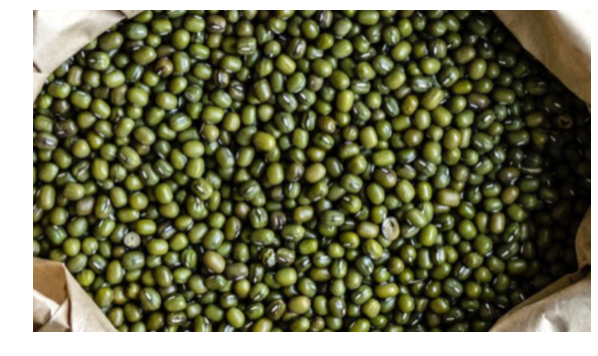

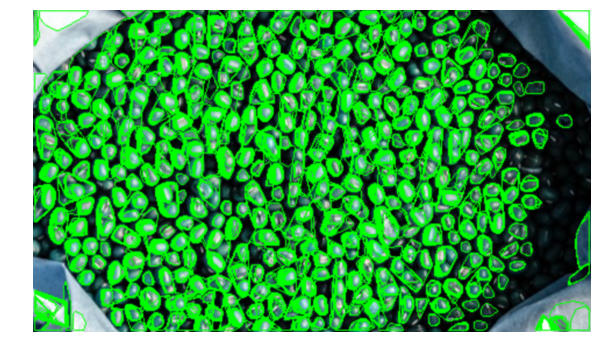

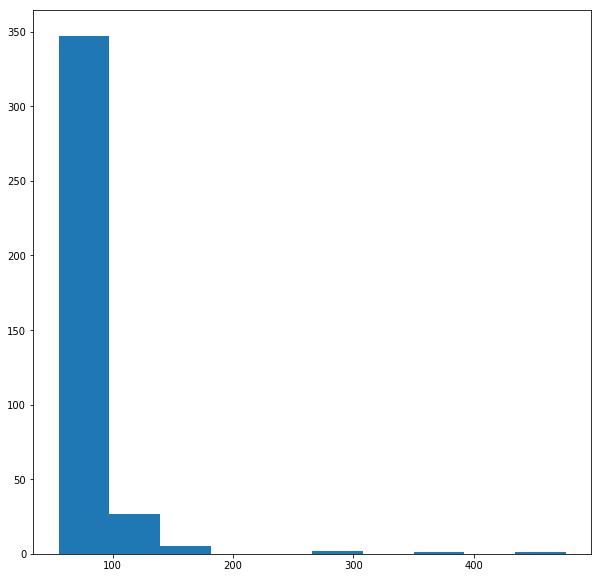

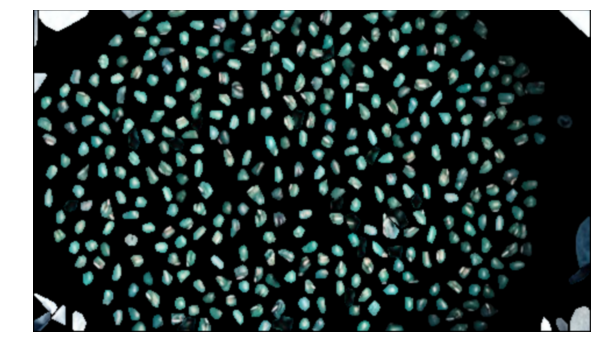

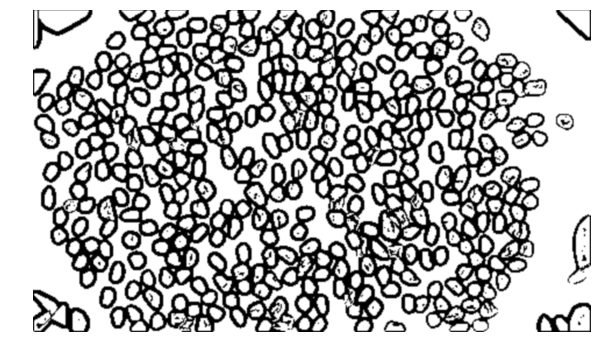

morphologyEx


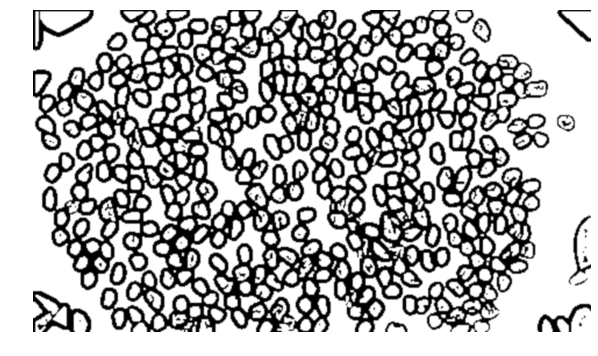

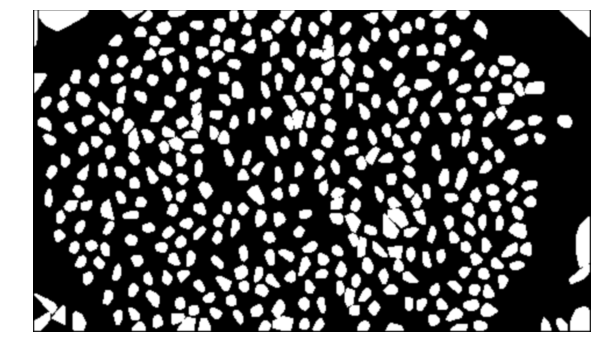

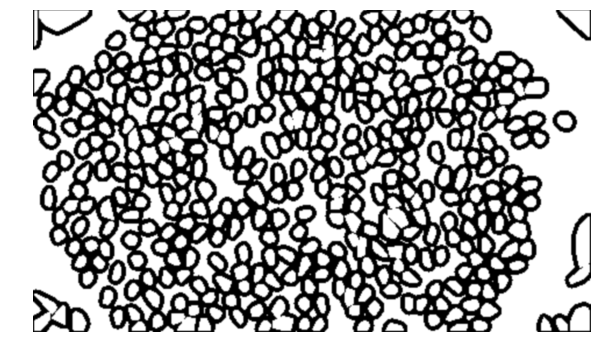

downloading https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/count/count2.jpg


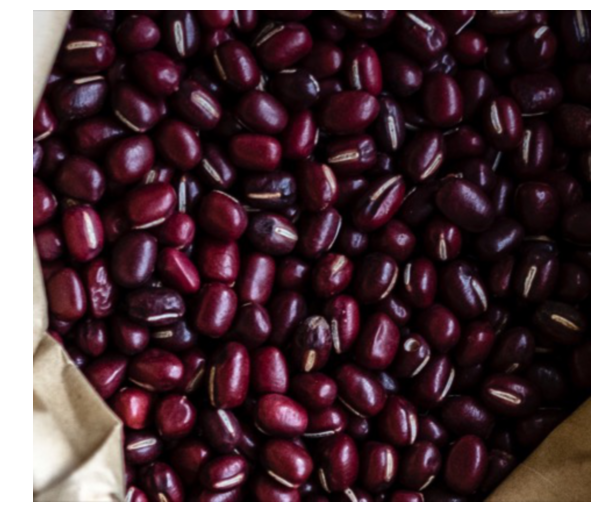

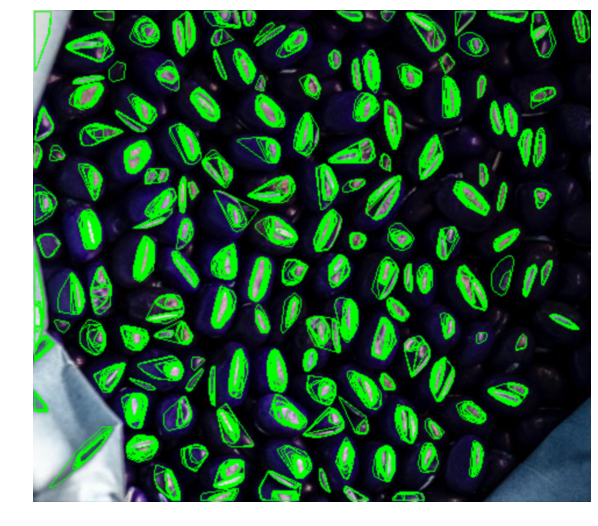

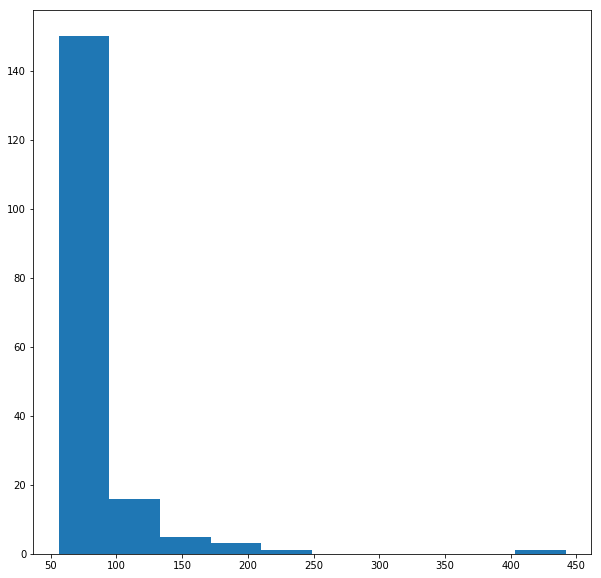

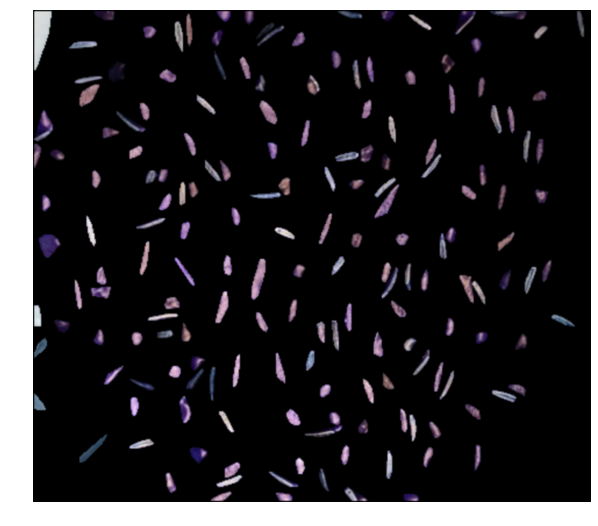

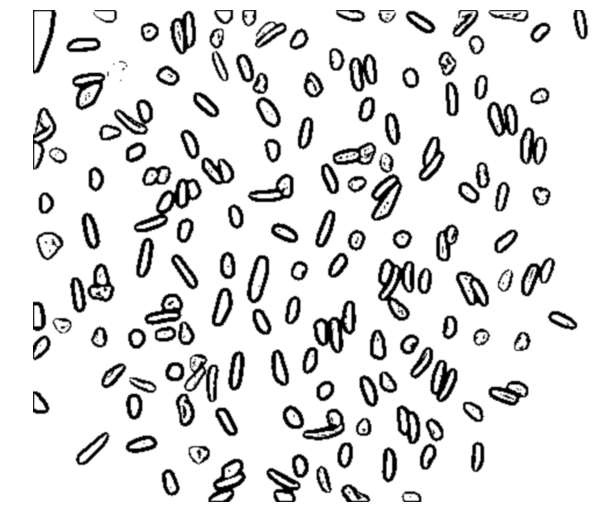

morphologyEx


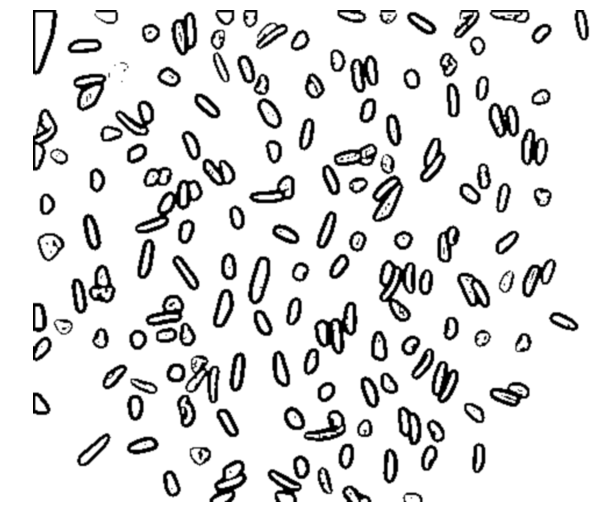

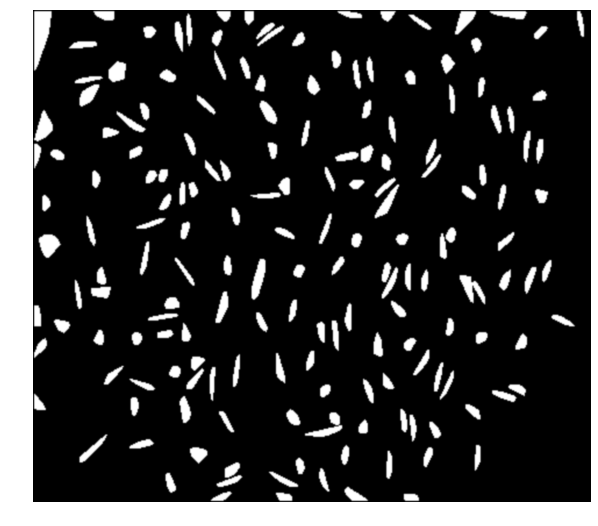

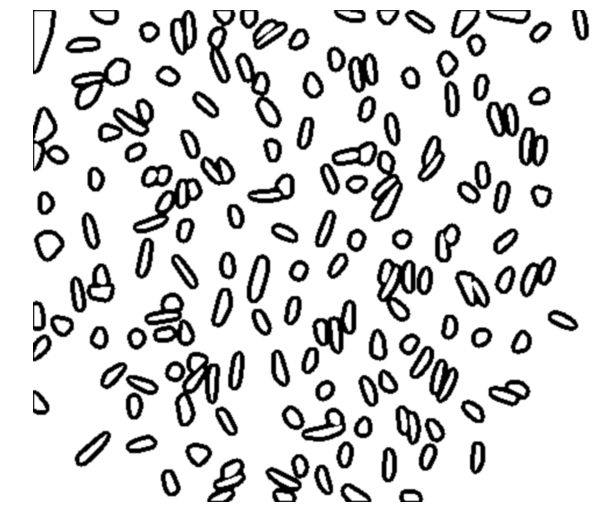

downloading https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/count/count3.jpg


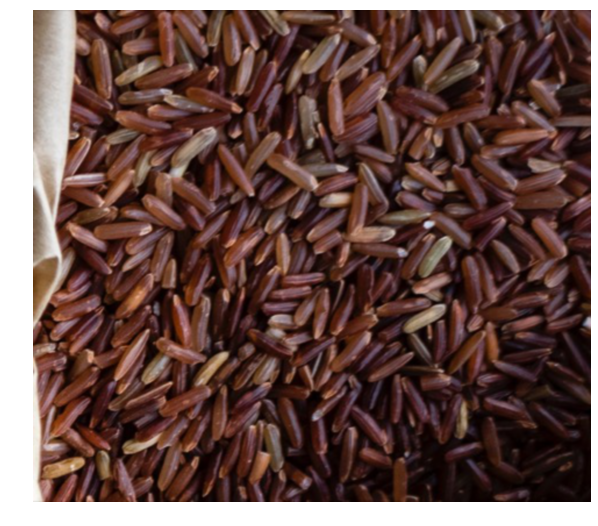

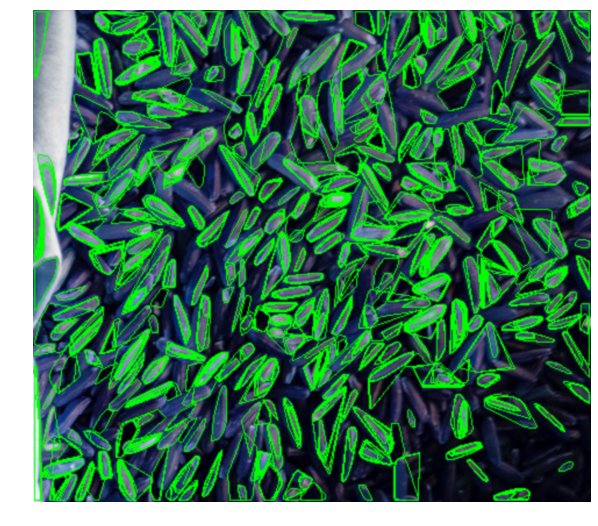

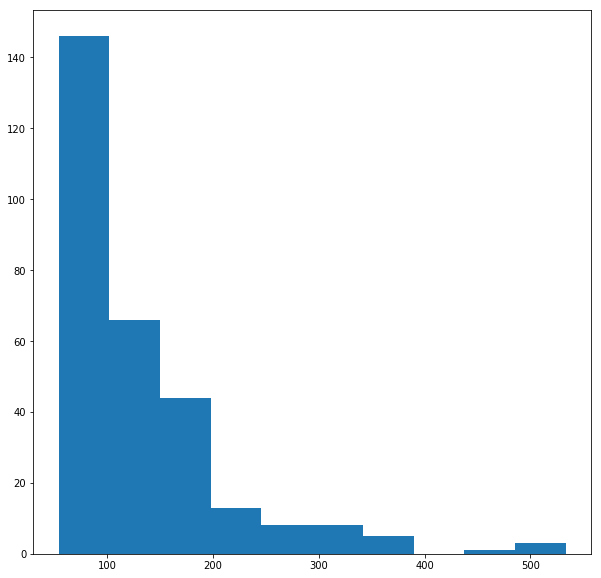

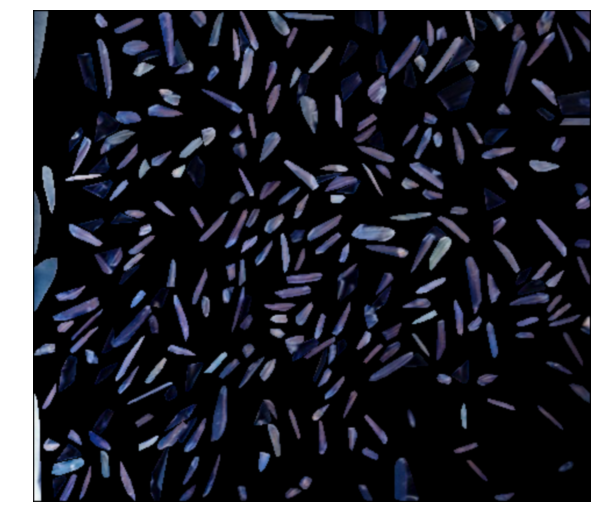

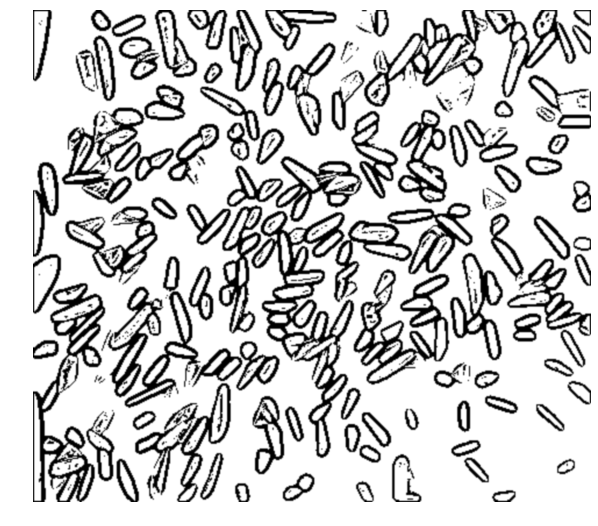

morphologyEx


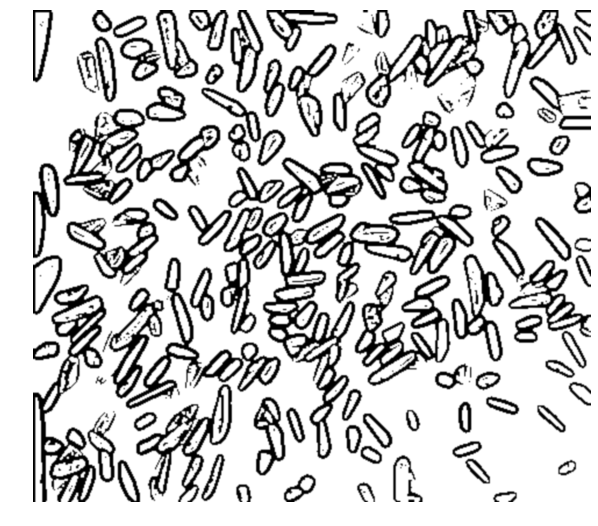

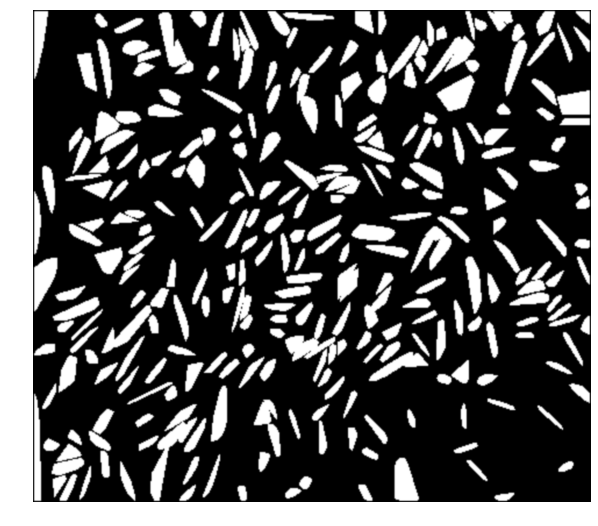

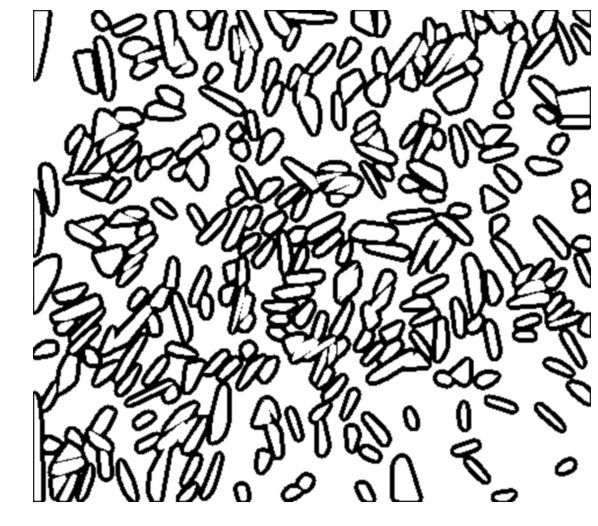

downloading https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/count/count4.jpg


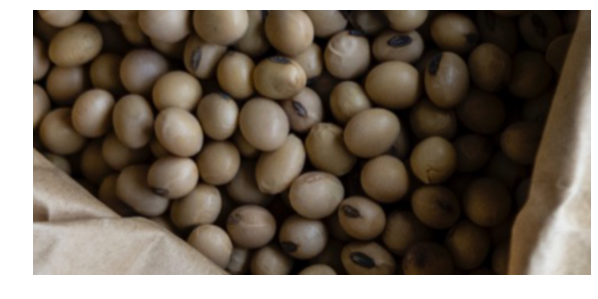

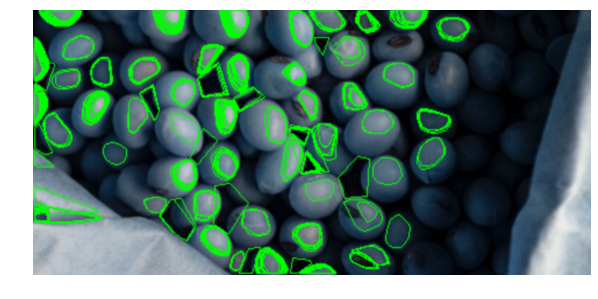

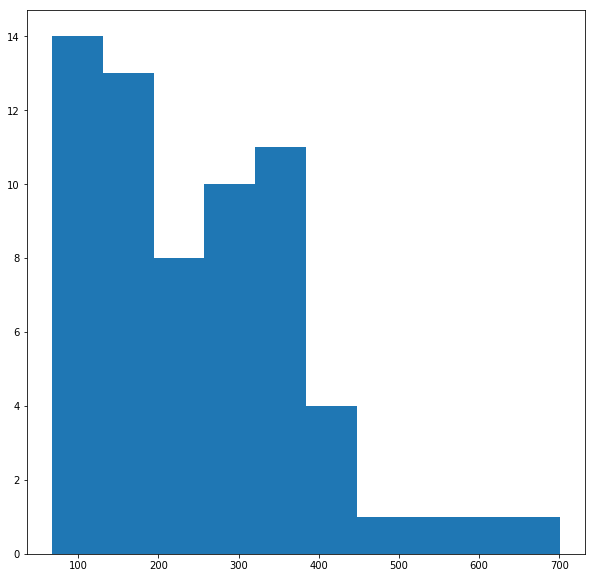

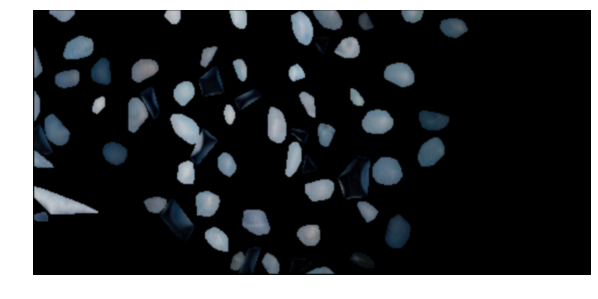

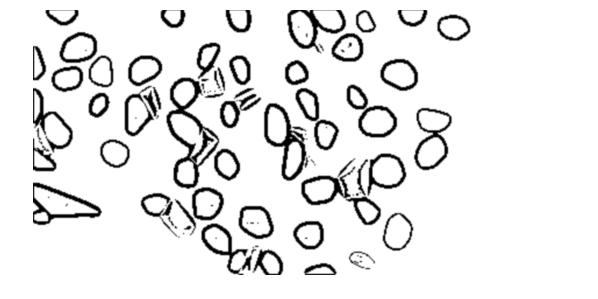

morphologyEx


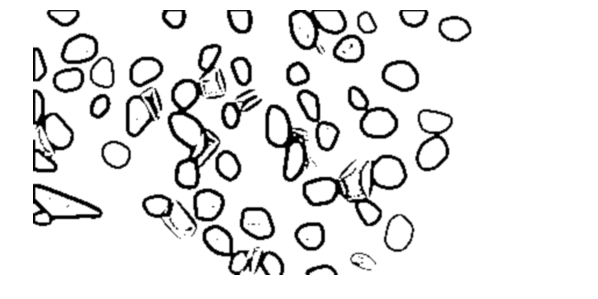

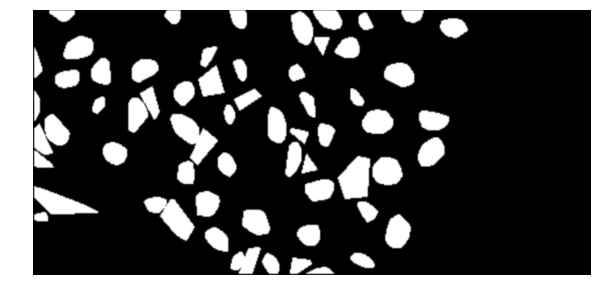

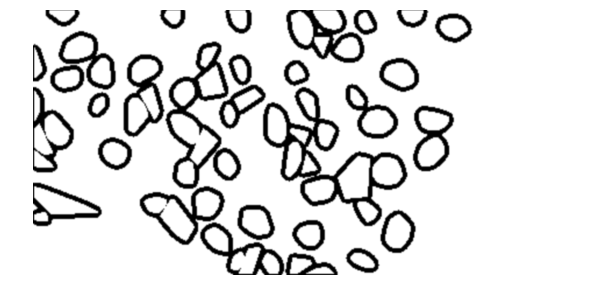

downloading https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/count/count5.jpg


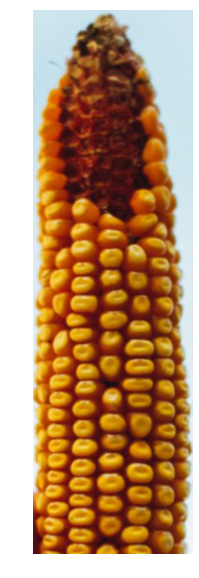

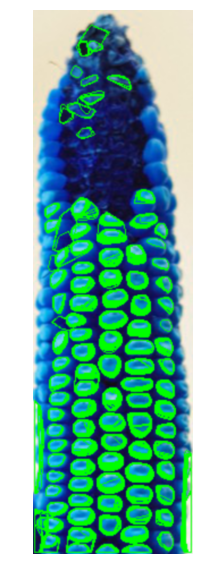

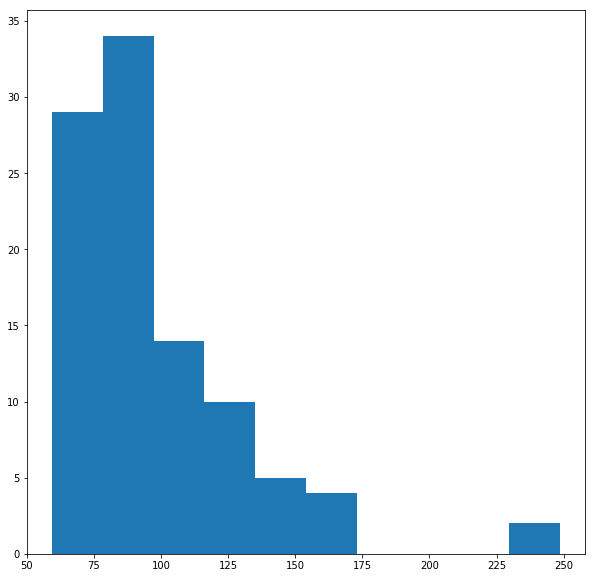

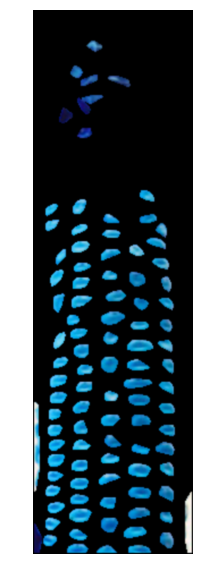

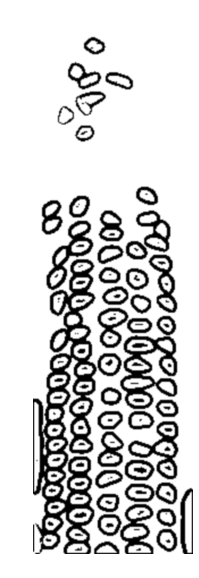

morphologyEx


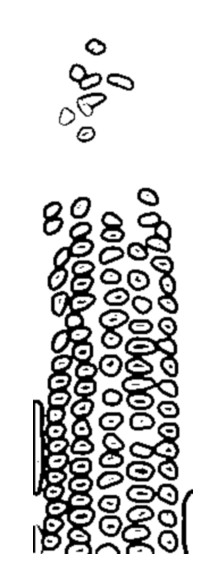

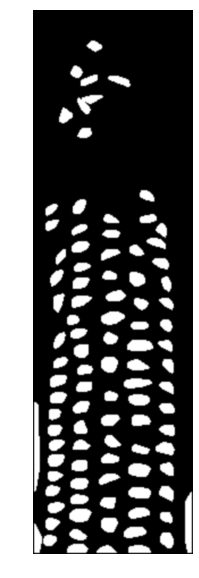

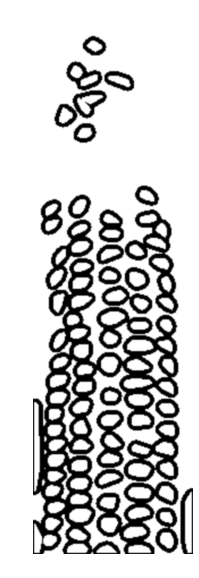

downloading https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/count/count6.jpg


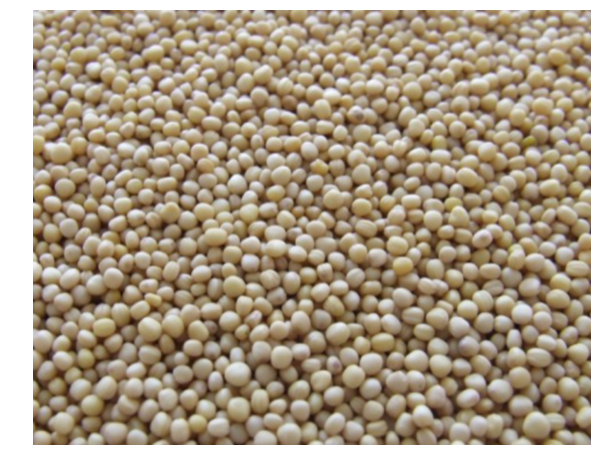

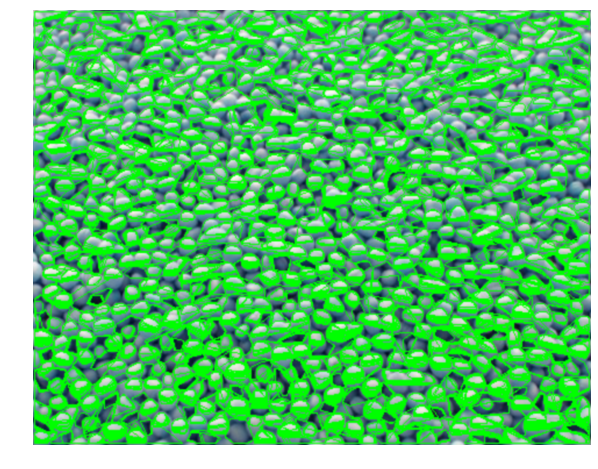

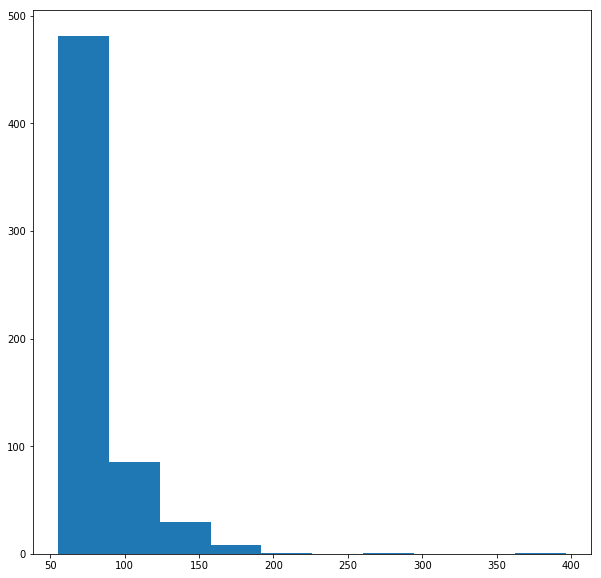

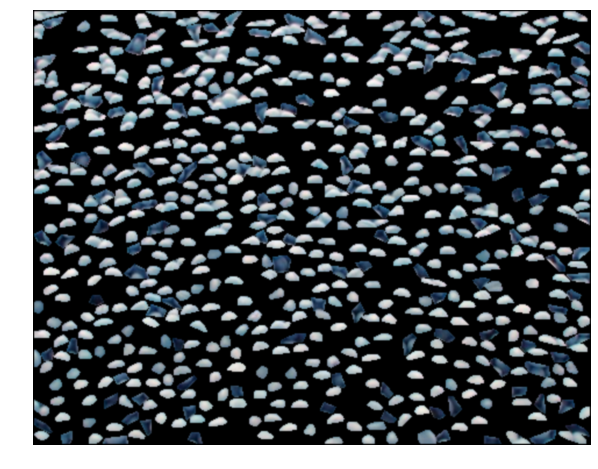

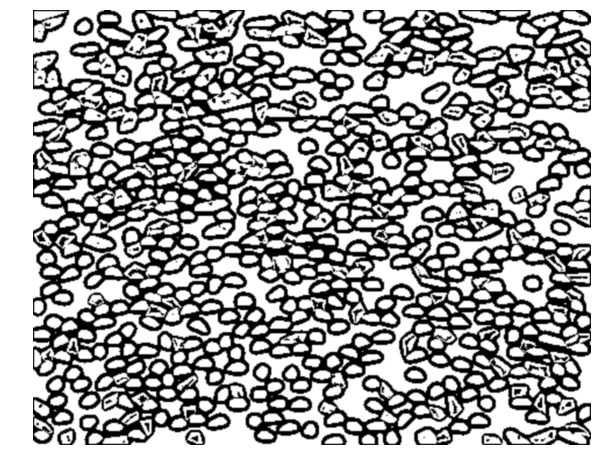

morphologyEx


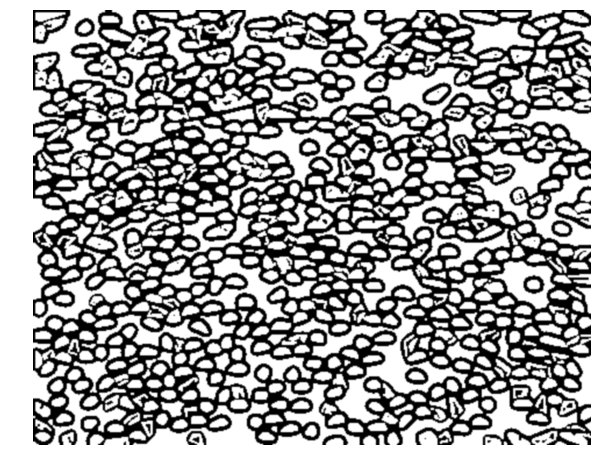

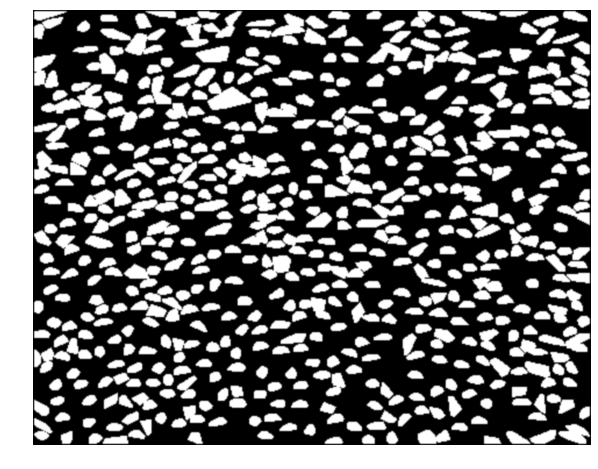

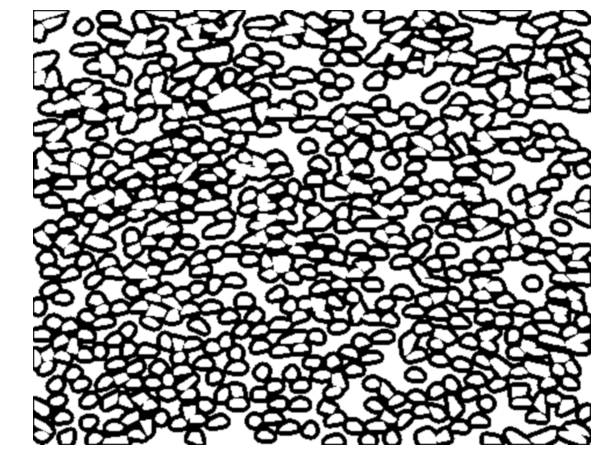

downloading https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/count/count7.jpg


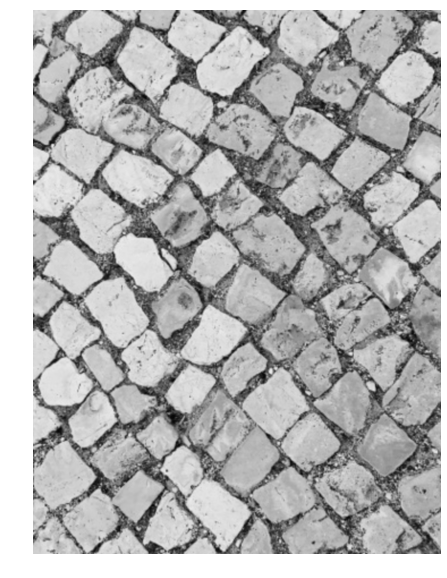

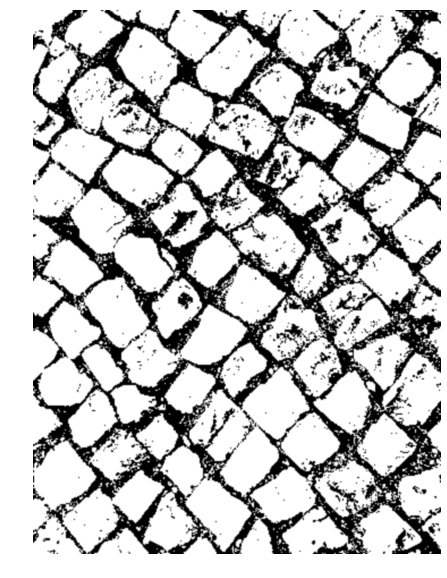

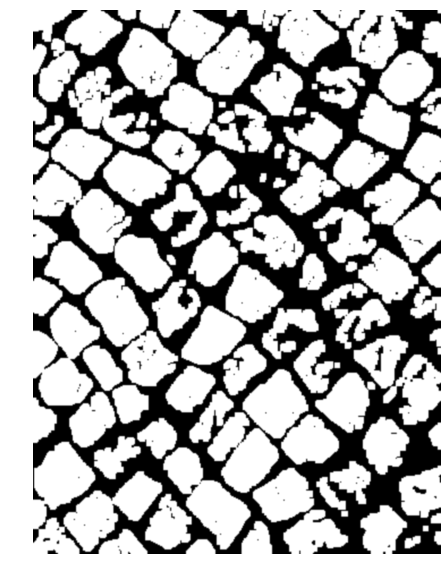

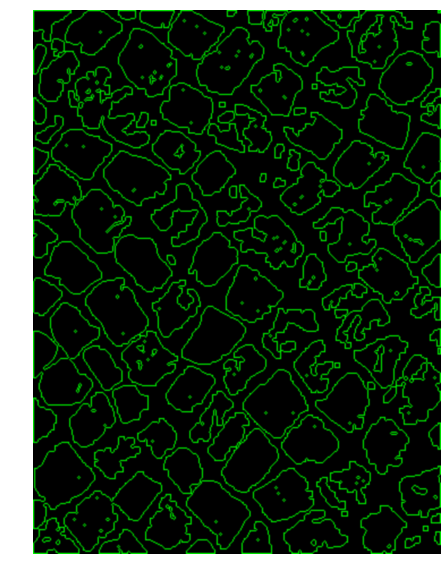

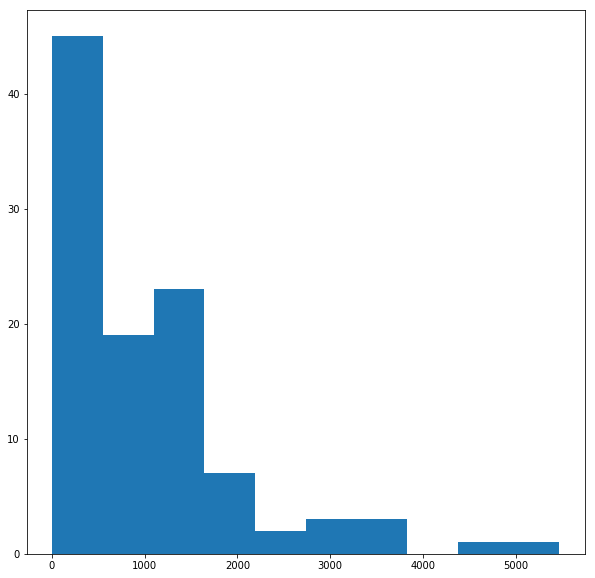

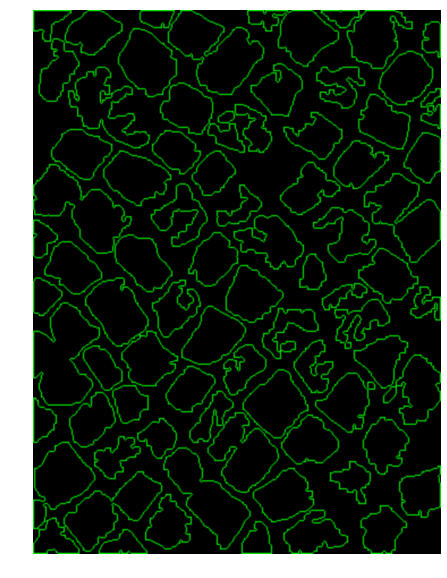

downloading https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/count/count8.jpg


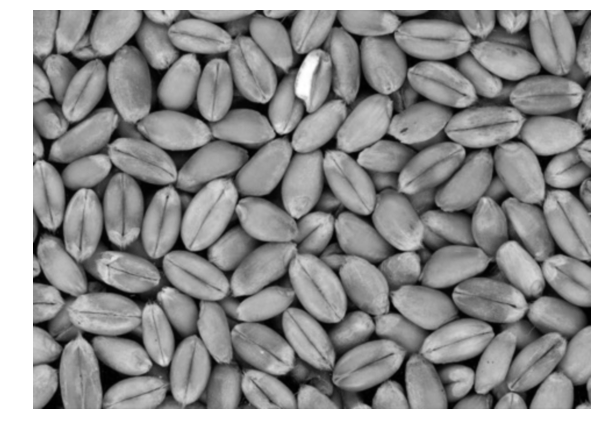

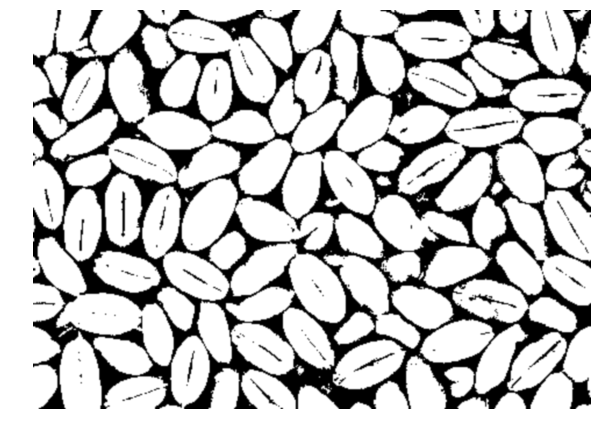

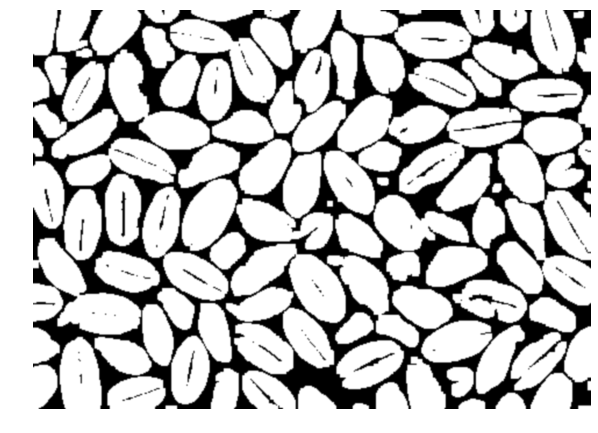

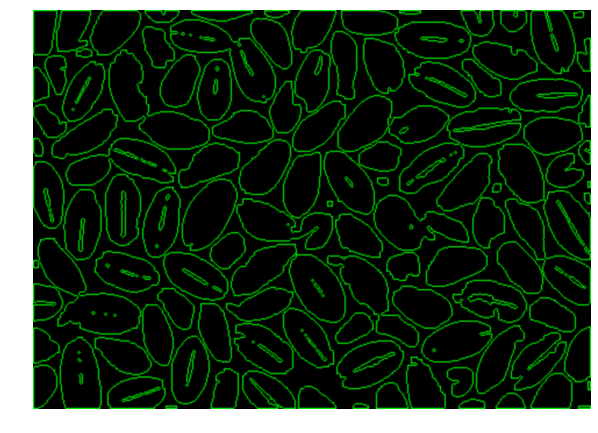

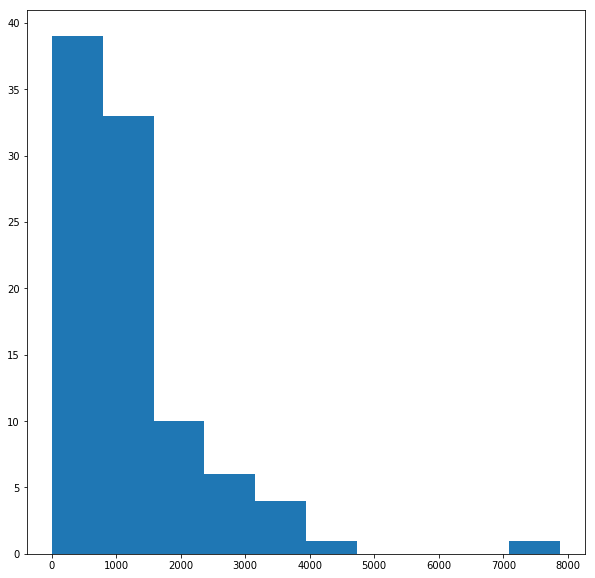

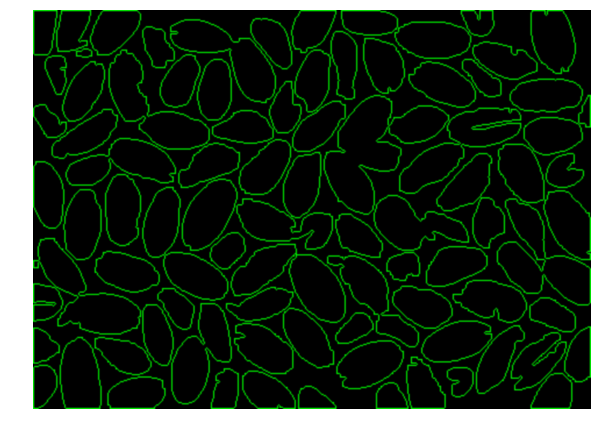

downloading https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/count/count9.jpg


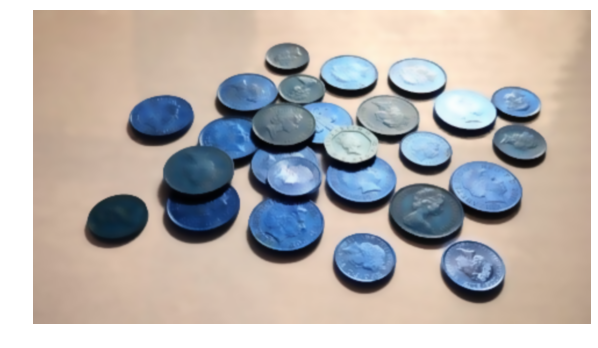

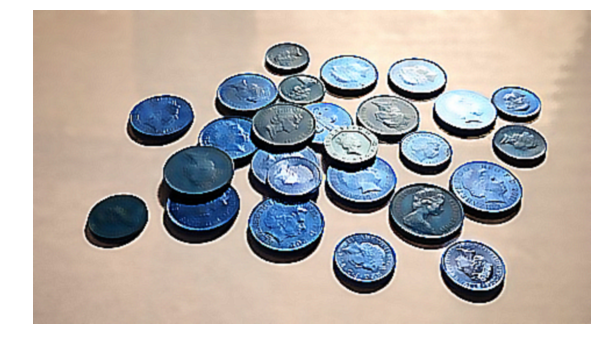

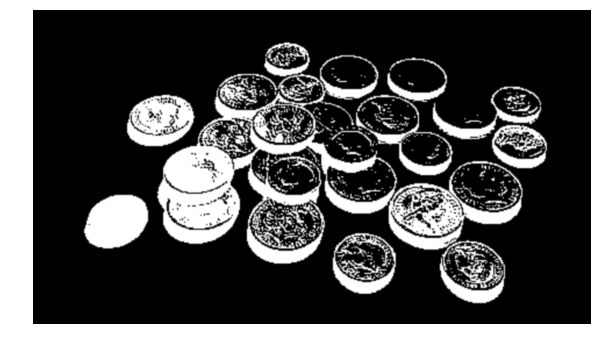

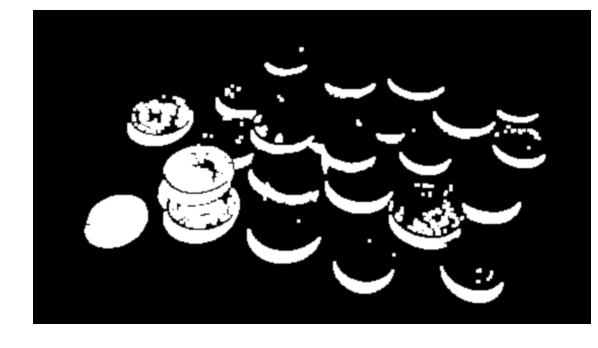

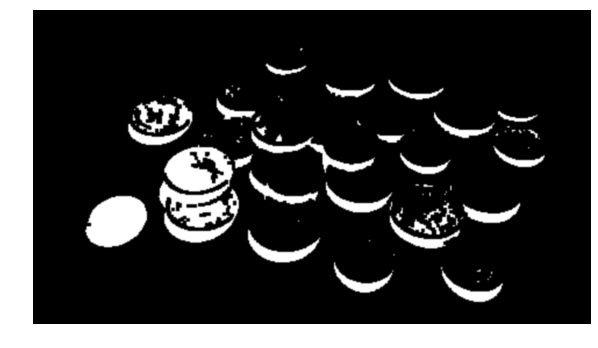

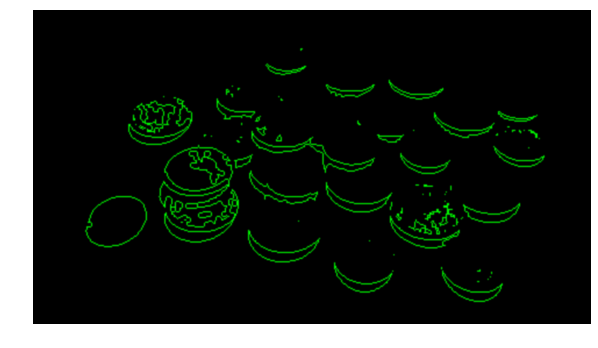

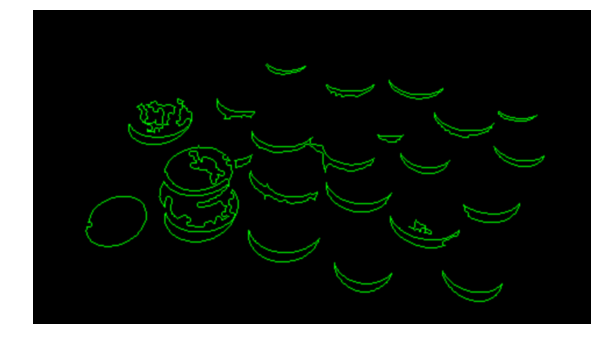

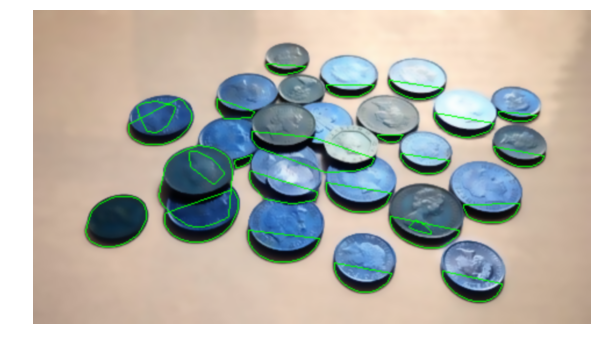

downloading https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/count/count10.jpg


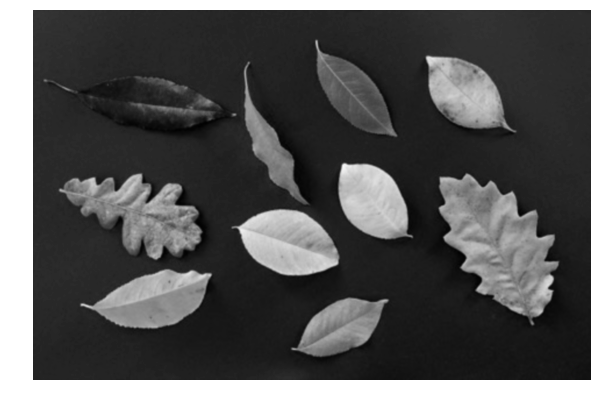

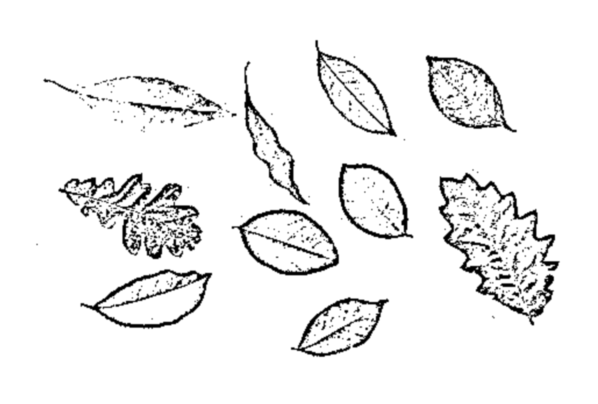

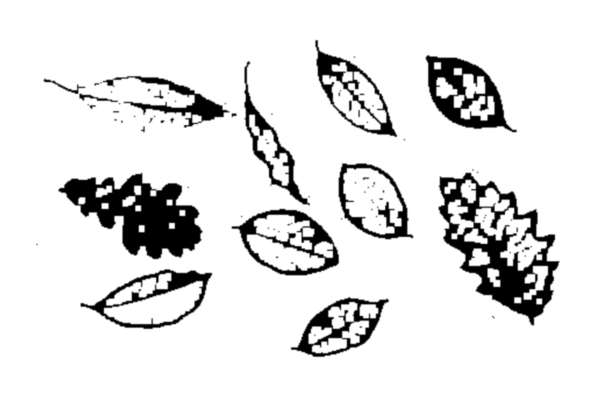

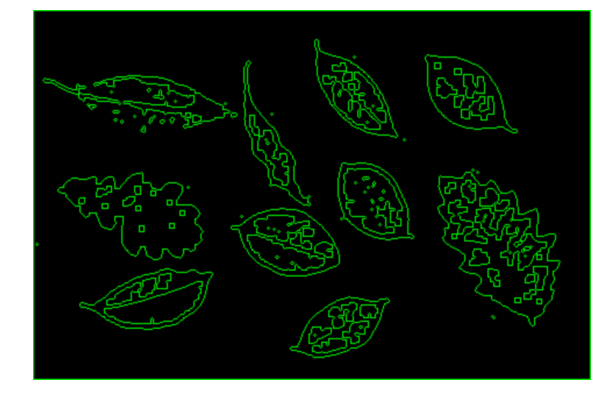

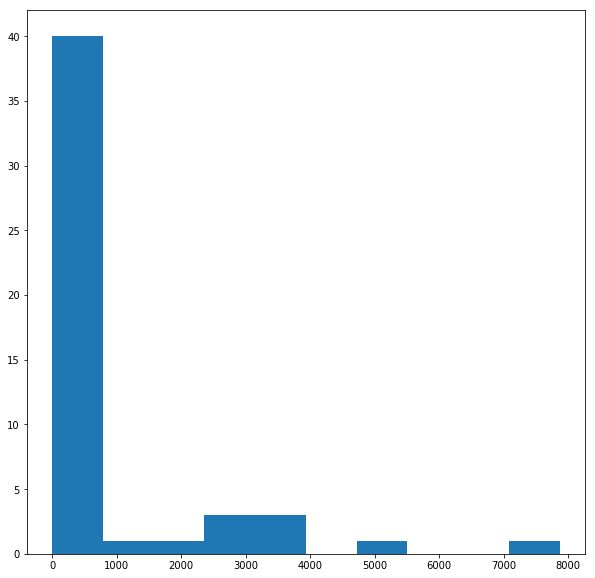

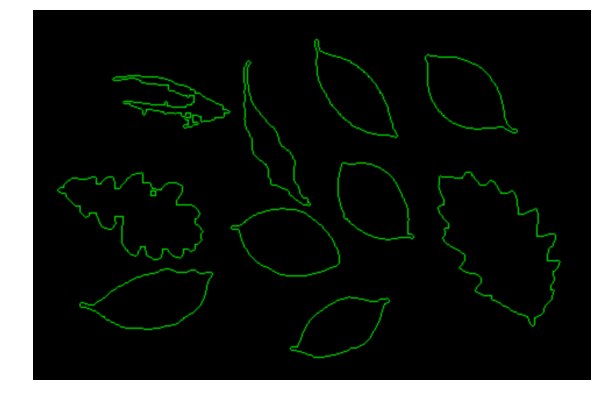

downloading https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/count/count11.jpg


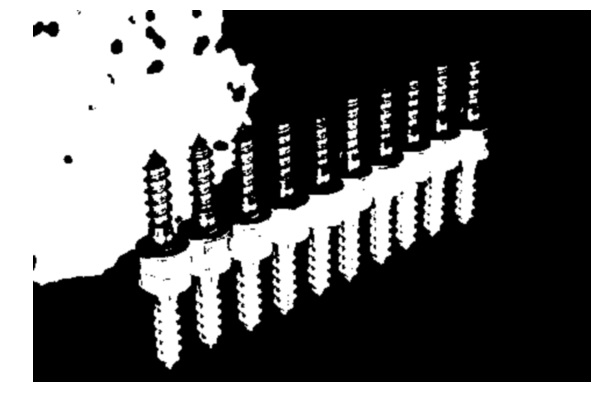

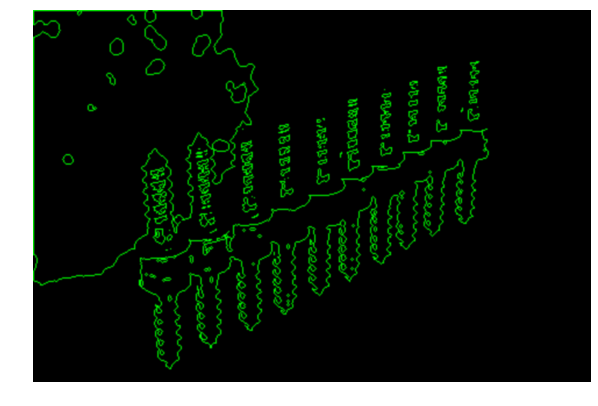

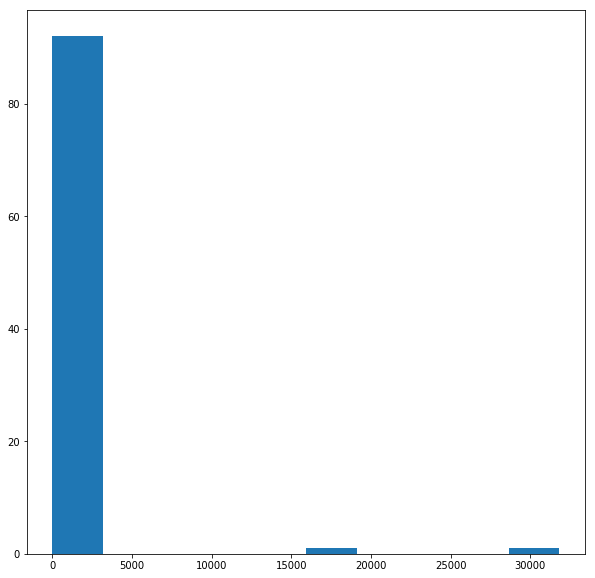

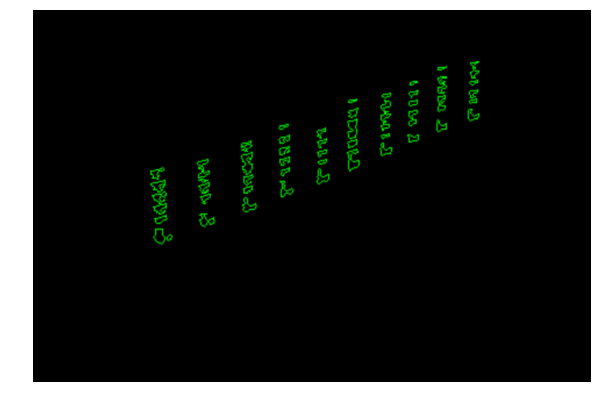

49


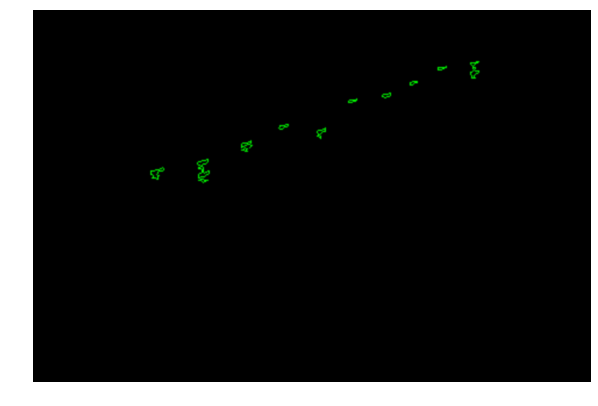

downloading https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/count/count12.jpg


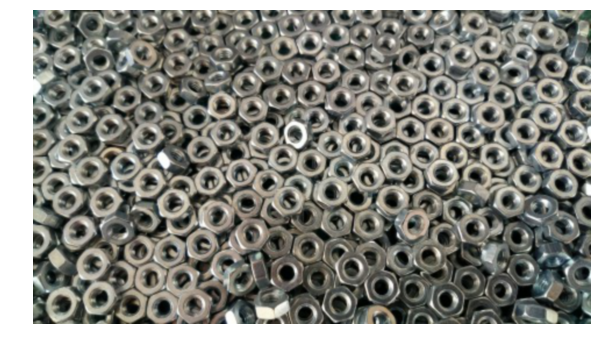

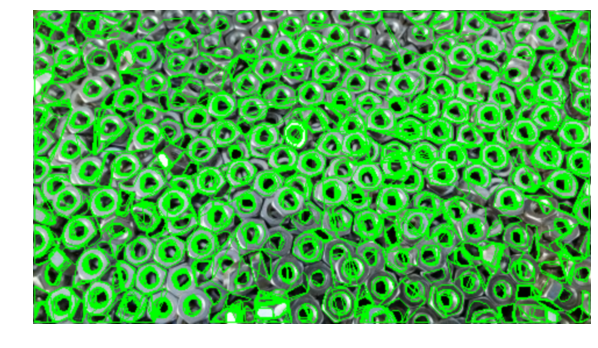

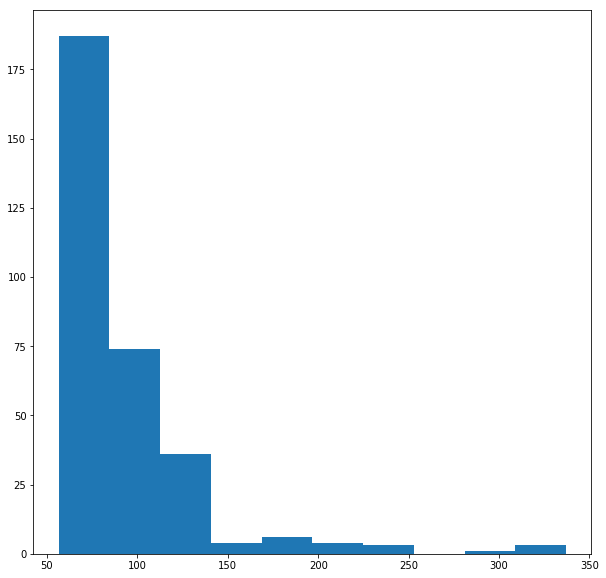

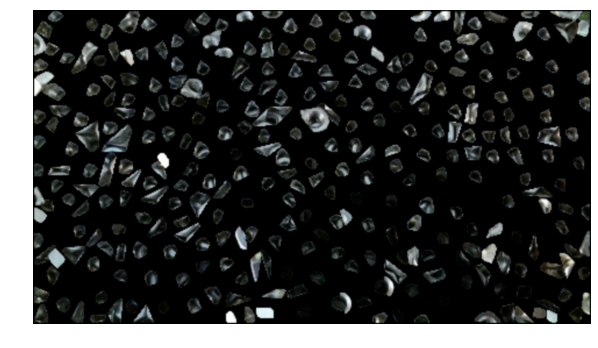

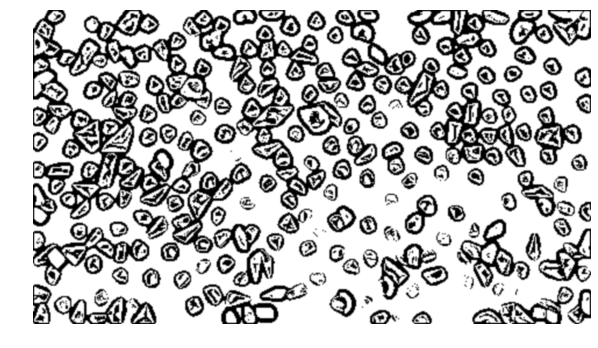

morphologyEx


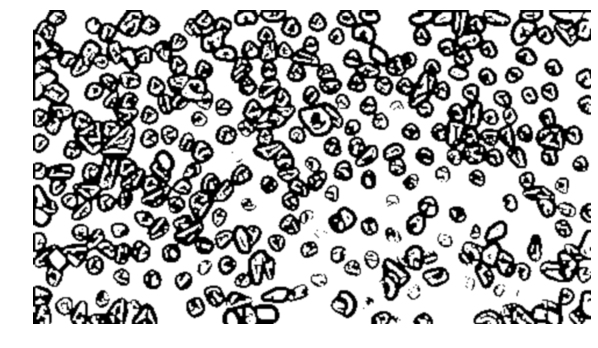

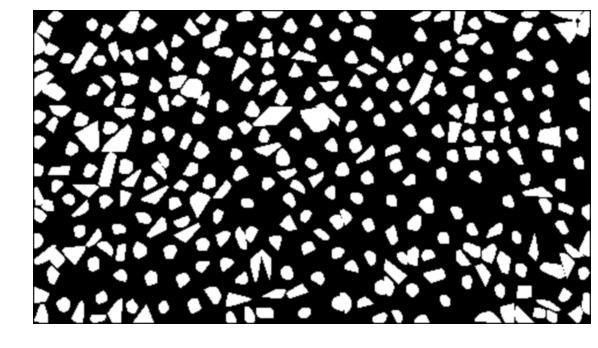

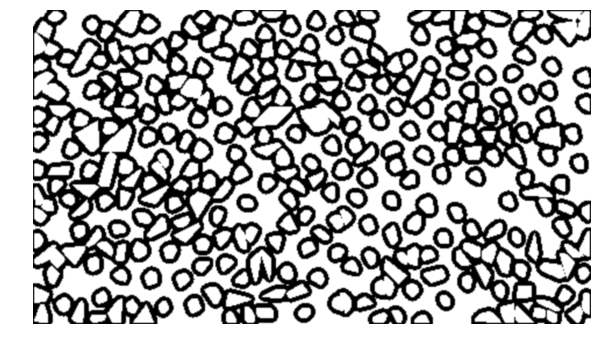

In [9]:
result = []
for img in urls:
    if img['alg'] == 'mser':
        objects_number = pipeline_mser(url_to_image(img['url']), img['delta'])
    
    elif img['alg'] == 'otsu' or img['alg'] == 'adaptive':
        objects_number = pipeline_threshold(url_to_image(img['url']), img['alg'])
    
    elif img['alg'] == 'search_and_merge':
        objects_number = search_and_merge(url_to_image(img['url']))
        
    elif img['alg'] == 'bilateral_bluring':
        objects_number = bilateral_bluring(url_to_image(img['url']))
    
    else:
        objects_number = -1
        
        
    result.append(objects_number)

# Final result!!!

In [10]:
for c, value in enumerate(result, 1):
    print('image #', c, ' : ', value)
    

image # 1  :  383
image # 2  :  176
image # 3  :  294
image # 4  :  64
image # 5  :  98
image # 6  :  607
image # 7  :  71
image # 8  :  73
image # 9  :  25
image # 10  :  10
image # 11  :  10
image # 12  :  318


# Warmup

### Watershed

https://docs.opencv.org/3.3.1/d3/db4/tutorial_py_watershed.html

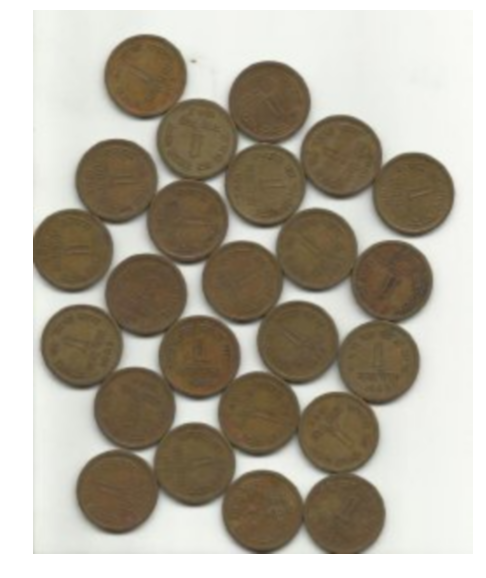

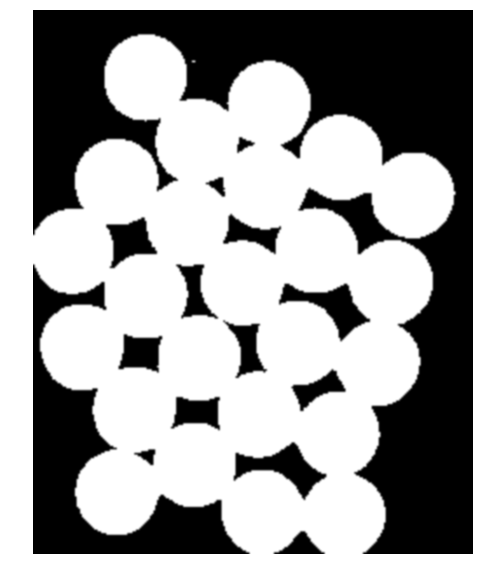

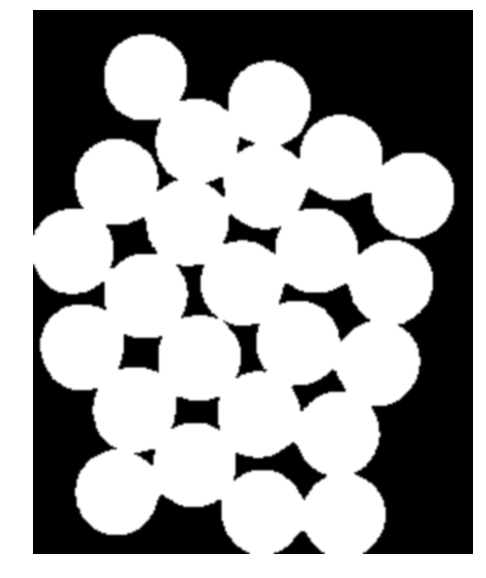

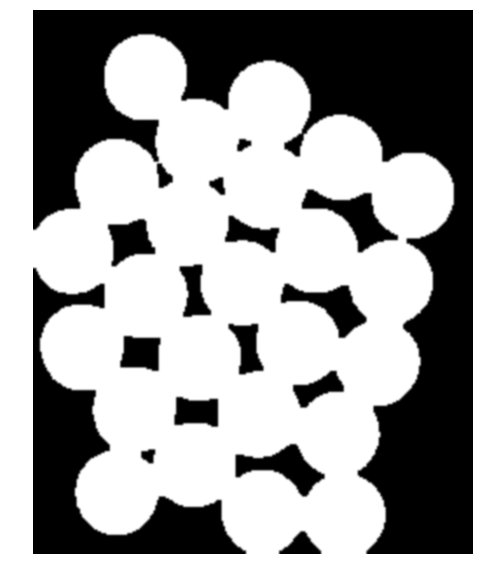

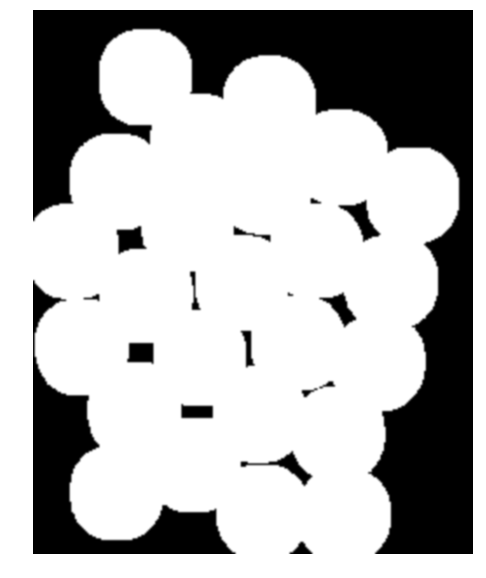

...

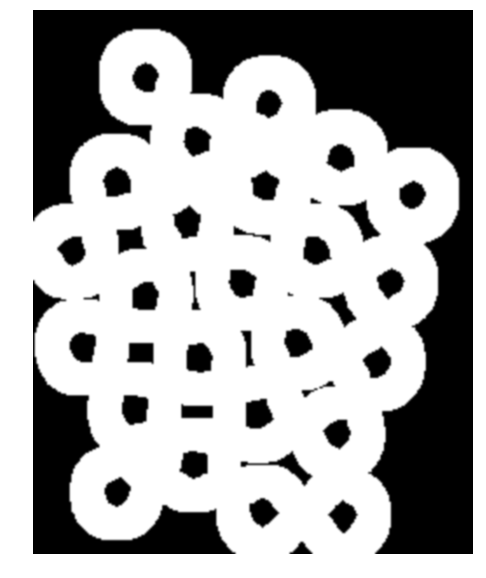

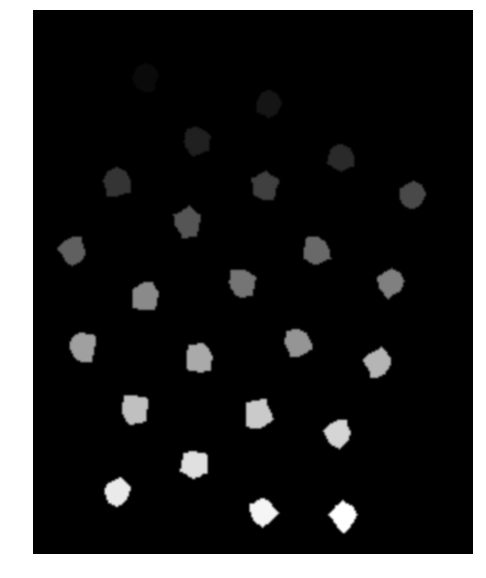

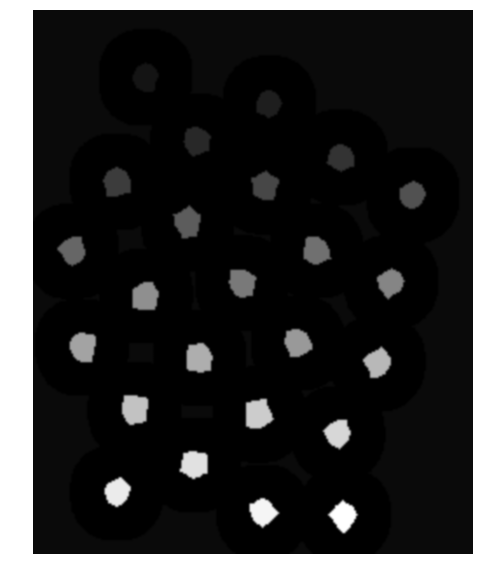

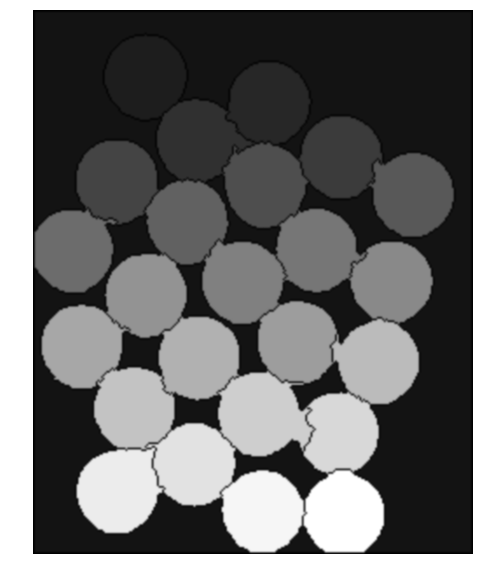

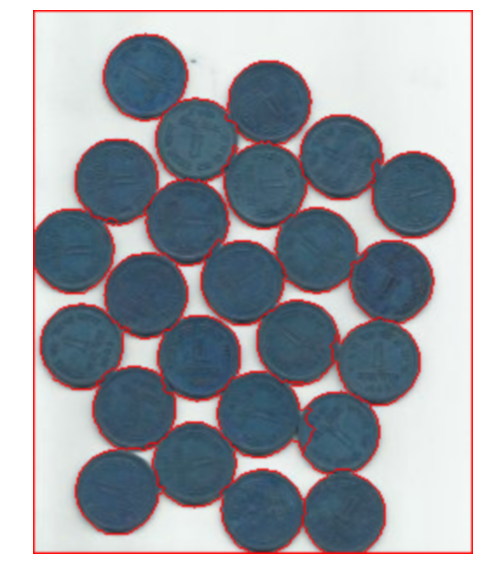

number_of_objects 25


In [11]:
def simple_pipeline(img):
    cv2_imshow(cv2.cvtColor(img,cv2.COLOR_BGR2RGB))
    
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    ret, thresh = cv2.threshold(gray,0,255,cv2.THRESH_BINARY_INV+cv2.THRESH_OTSU)
    plt.imshow(thresh, cmap = 'gray', interpolation = 'bicubic')
    plt.axis("off")
    plt.show()

    kernel = np.ones((3,3),np.uint8)
    opening = cv2.morphologyEx(thresh,cv2.MORPH_OPEN,kernel, iterations = 1)
    plt.imshow(opening, cmap = 'gray', interpolation = 'bicubic')
    plt.axis("off")
    plt.show()
    closing = cv2.morphologyEx(opening, cv2.MORPH_CLOSE, kernel, iterations = 1)
    plt.imshow(closing, cmap = 'gray', interpolation = 'bicubic')
    plt.axis("off")
    plt.show()
    opening = closing
    
    # sure background area
    sure_bg = cv2.dilate(opening,kernel,iterations=3)
    plt.imshow(sure_bg, cmap = 'gray', interpolation = 'bicubic')
    plt.axis("off")
    plt.show()

    # Finding sure foreground area
    dist_transform = cv2.distanceTransform(opening,cv2.DIST_L2,5)
    plt.imshow(dist_transform, cmap = 'gray', interpolation = 'bicubic')
    plt.axis("off")
    plt.show()

    ret, sure_fg = cv2.threshold(dist_transform,0.7*dist_transform.max(),255,0)
    plt.imshow(sure_fg, cmap = 'gray', interpolation = 'bicubic')
    plt.axis("off")
    plt.show()

    # Finding unknown region
    sure_fg = np.uint8(sure_fg)
    unknown = cv2.subtract(sure_bg,sure_fg)
    plt.imshow(unknown, cmap = 'gray', interpolation = 'bicubic')
    plt.axis("off")
    plt.show()

    # Marker labelling
    ret, markers = cv2.connectedComponents(sure_fg)
    # Add one to all labels so that sure background is not 0, but 1
    markers = markers+1
    plt.imshow(markers, cmap = 'gray', interpolation = 'bicubic')
    plt.axis("off")
    plt.show()

    # Now, mark the region of unknown with zero
    markers[unknown==255] = 0
    plt.imshow(markers, cmap = 'gray', interpolation = 'bicubic')
    plt.axis("off")
    plt.show()

    markers = cv2.watershed(img,markers)
    img[markers == -1] = [255,0,0]

    plt.imshow(markers, cmap = 'gray', interpolation = 'bicubic')
    plt.axis("off")
    plt.show()

    plt.imshow(img, cmap = 'gray', interpolation = 'bicubic')
    plt.axis("off")
    plt.show()
    
    return ret

img = cv2.imread('coins.jpg')
number_of_objects = simple_pipeline(img)
print('number_of_objects', number_of_objects)

### Ellipse detection

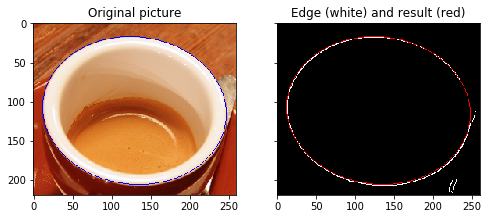

In [12]:
import matplotlib.pyplot as plt

from skimage import data, color, img_as_ubyte
from skimage.feature import canny
from skimage.transform import hough_ellipse
from skimage.draw import ellipse_perimeter

# Load picture, convert to grayscale and detect edges
image_rgb = data.coffee()[0:220, 160:420]
image_gray = color.rgb2gray(image_rgb)
edges = canny(image_gray, sigma=2.0,
              low_threshold=0.55, high_threshold=0.8)

# Perform a Hough Transform
# The accuracy corresponds to the bin size of a major axis.
# The value is chosen in order to get a single high accumulator.
# The threshold eliminates low accumulators
result = hough_ellipse(edges, accuracy=20, threshold=250,
                       min_size=100, max_size=120)
result.sort(order='accumulator')

# Estimated parameters for the ellipse
best = list(result[-1])
yc, xc, a, b = [int(round(x)) for x in best[1:5]]
orientation = best[5]

# Draw the ellipse on the original image
cy, cx = ellipse_perimeter(yc, xc, a, b, orientation)
image_rgb[cy, cx] = (0, 0, 255)
# Draw the edge (white) and the resulting ellipse (red)
edges = color.gray2rgb(img_as_ubyte(edges))
edges[cy, cx] = (250, 0, 0)

fig2, (ax1, ax2) = plt.subplots(ncols=2, nrows=1, figsize=(8, 4),
                                sharex=True, sharey=True)

ax1.set_title('Original picture')
ax1.imshow(image_rgb)

ax2.set_title('Edge (white) and result (red)')
ax2.imshow(edges)

plt.show()

### Descriptors

downloading https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/count/count11.jpg


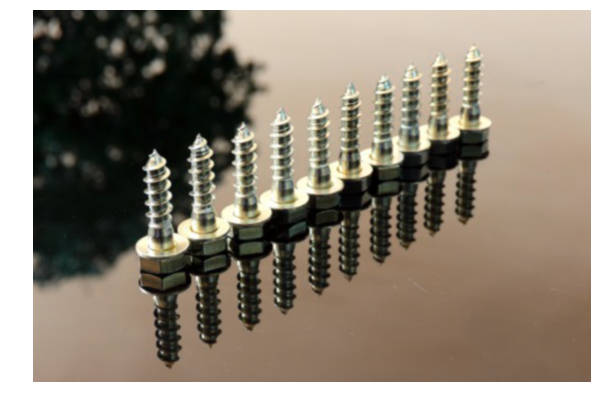

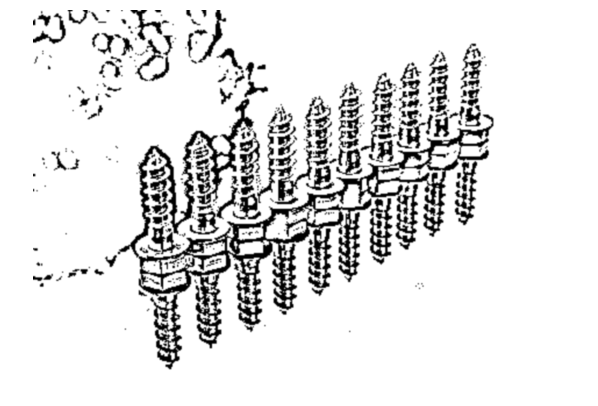

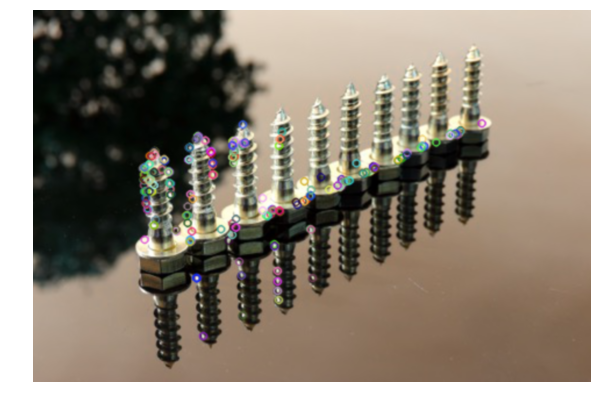

In [13]:
#sift = cv2.xfeatures2d.SIFT_create()
#surf = cv2.xfeatures2d.SURF_create()
img = url_to_image("https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/count/count11.jpg")
plt.imshow(img, cmap = 'gray', interpolation = 'bicubic')
plt.axis("off")
plt.show()

#blur = cv2.GaussianBlur(img,(5,5),0)
#kernel = np.array([[-1,-1,-1], [-1,9,-1], [-1,-1,-1]])
#img = cv2.filter2D(img, -1, kernel)

grayscaled = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
thresh2 = cv2.adaptiveThreshold(grayscaled, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 11, 6)

# edges = cv2.Canny(img,100,200)
plt.imshow(thresh2, cmap = 'gray', interpolation = 'bicubic')
plt.axis("off")
plt.show()

orb = cv2.ORB_create(nfeatures=250)
keypoints_orb, descriptors = orb.detectAndCompute(img, None)
img = cv2.drawKeypoints(img, keypoints_orb, None)
#img = cv2.drawKeypoints(img,keypoints_orb,None,(255,0,0),2)

plt.imshow(img, cmap = 'gray', interpolation = 'bicubic')
plt.axis("off")
plt.show()

### Super filters

downloading https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/count/count11.jpg


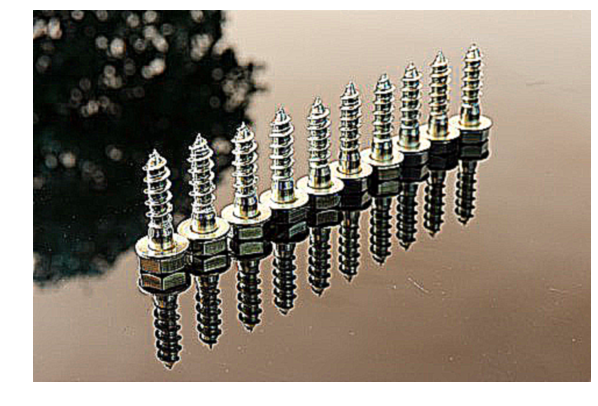

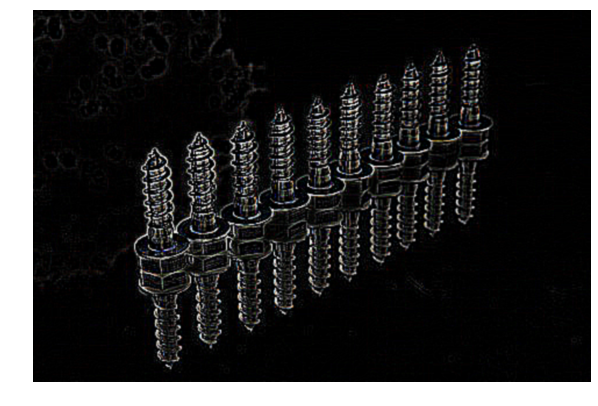

In [14]:
src = url_to_image("https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/count/count11.jpg")

# Create a kernel that we will use to sharpen our image
# an approximation of second derivative, a quite strong kernel
kernel = np.array([[1, 1, 1], [1, -8, 1], [1, 1, 1]], dtype=np.float32)
imgLaplacian = cv2.filter2D(src, cv2.CV_32F, kernel)
sharp = np.float32(src)
imgResult = sharp - imgLaplacian
# convert back to 8bits gray scale
imgResult = np.clip(imgResult, 0, 255)
imgResult = imgResult.astype('uint8')
imgLaplacian = np.clip(imgLaplacian, 0, 255)
imgLaplacian = np.uint8(imgLaplacian)
#cv.imshow('Laplace Filtered Image', imgLaplacian)

cv2_imshow(imgResult)
cv2_imshow(imgLaplacian)

# Tune and Learn parameters

downloading https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/count/count11.jpg


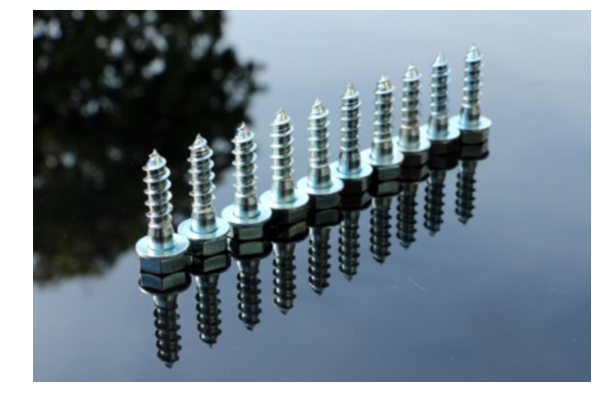

In [15]:
# otsu

image = url_to_image("https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/count/count11.jpg")

grayscaled = cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)
cv2_imshow(cv2.cvtColor(image,cv2.COLOR_BGR2RGB))

trackbarName = 'Test' 
windowName = 'TestW'

def on_trackbar(val):
    opening_m = cv2.getTrackbarPos('opening_m', windowName)
    opening_i = cv2.getTrackbarPos('opening_i', windowName)
    erode_i = cv2.getTrackbarPos('erode_i', windowName)
    
    ret, thresh = cv2.threshold(grayscaled,0,255,cv2.THRESH_BINARY_INV+cv2.THRESH_OTSU)

    kernel = np.ones((opening_m,opening_m),np.uint8)
    opening = cv2.morphologyEx(thresh,cv2.MORPH_OPEN,kernel, iterations = opening_i)
    
    closing = cv2.morphologyEx(opening, cv2.MORPH_CLOSE, kernel)
    opening = closing

    #kernel = np.ones((opening_m,opening_m),np.uint8)
    #erosion = cv2.erode(opening,kernel,iterations = erode_i)

    # Finding sure foreground area
    dist_transform = cv2.distanceTransform(opening,cv2.DIST_L2, 5)
    dist1 = cv2.normalize(dist_transform, None, 255,0, cv2.NORM_MINMAX, cv2.CV_8UC1)

    ret, sure_fg = cv2.threshold(dist_transform,0.1*dist_transform.max(),255,0)
    dist2 = cv2.normalize(sure_fg, None, 255,0, cv2.NORM_MINMAX, cv2.CV_8UC1)

    img_show = np.hstack((opening, dist1, dist2))
    cv2.imshow(windowName, img_show)
        
               
cv2.namedWindow(windowName)

cv2.createTrackbar('opening_m', windowName, 4, 50, on_trackbar)
cv2.createTrackbar('opening_i', windowName, 1, 50, on_trackbar)
cv2.createTrackbar('erode_i', windowName, 1, 50, on_trackbar)

# Show some stuff
on_trackbar(3)
# Wait until user press some key
cv2.waitKey()
cv2.destroyAllWindows()

downloading https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/count/count11.jpg


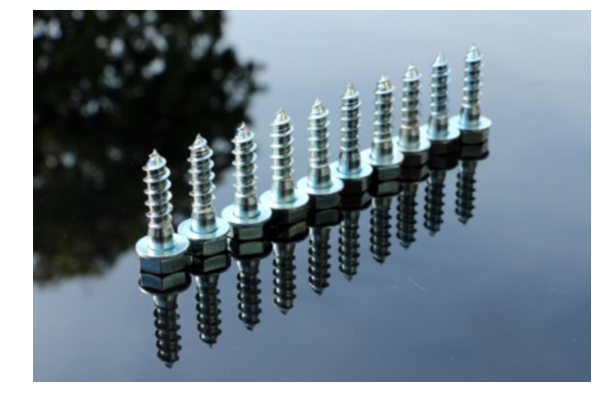

34


In [16]:
# adaptive thres
image = url_to_image("https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/count/count11.jpg")

grayscaled = cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)
cv2_imshow(cv2.cvtColor(image,cv2.COLOR_BGR2RGB))

trackbarName = 'Test' 
windowName = 'TestW'

def on_trackbar(val):
    sl1 = cv2.getTrackbarPos('sl1', windowName)
    sl2 = cv2.getTrackbarPos('sl2', windowName)
    
    opening_m = cv2.getTrackbarPos('opening_m', windowName)
    opening_i = cv2.getTrackbarPos('opening_i', windowName)
    erode_i = cv2.getTrackbarPos('erode_i', windowName)
    mser_i = cv2.getTrackbarPos('mser_i', windowName)
    
    if sl1%2==1 and sl1>1 and sl2%2==0:
        thresh = cv2.adaptiveThreshold(grayscaled, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, sl1, sl2)
        thresh = 255 - thresh
       
        kernel = np.ones((opening_m,opening_m),np.uint8)
        #opening = cv2.morphologyEx(thresh,cv2.MORPH_OPEN,kernel, iterations = opening_i)
        opening = cv2.dilate(thresh,kernel,iterations = opening_i)
        closing = cv2.morphologyEx(opening, cv2.MORPH_CLOSE, kernel, iterations = erode_i)
        opening = closing
        
        #kernel = np.ones((opening_m,opening_m),np.uint8)
        #erosion = cv2.erode(opening,kernel,iterations = erode_i)
        
        dist_transform = cv2.distanceTransform(opening,cv2.DIST_L2, 5)
        dist2 = cv2.normalize(dist_transform, None, 255,0, cv2.NORM_MINMAX, cv2.CV_8UC1)
        
        ret, sure_fg = cv2.threshold(dist_transform,0.5*dist_transform.max(),255,0)
        #dist2 = cv2.normalize(sure_fg, None, 255,0, cv2.NORM_MINMAX, cv2.CV_8UC1)
        
        sure_fg = np.uint8(sure_fg)
        ret, markers = cv2.connectedComponents(sure_fg)
        print(ret)
        
#         contours, hierarchy = cv2.findContours(sure_fg, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
#         countour_img1 = np.full_like(image, 0)
#         cv2.drawContours(countour_img1, contours, -1, (0,255,0), 1)
    
        img_show = np.hstack((sure_fg, opening, dist2))
        cv2.imshow(windowName, img_show)
               
cv2.namedWindow(windowName)

cv2.createTrackbar('sl1', windowName, 11, 50, on_trackbar)
cv2.createTrackbar('sl2', windowName, 8, 50, on_trackbar)
cv2.createTrackbar('opening_m', windowName, 3, 50, on_trackbar)
cv2.createTrackbar('opening_i', windowName, 1, 50, on_trackbar)
cv2.createTrackbar('erode_i', windowName, 1, 50, on_trackbar)

# Show some stuff
on_trackbar(3)
# Wait until user press some key
cv2.waitKey()
cv2.destroyAllWindows()

downloading https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/count/count9.jpg


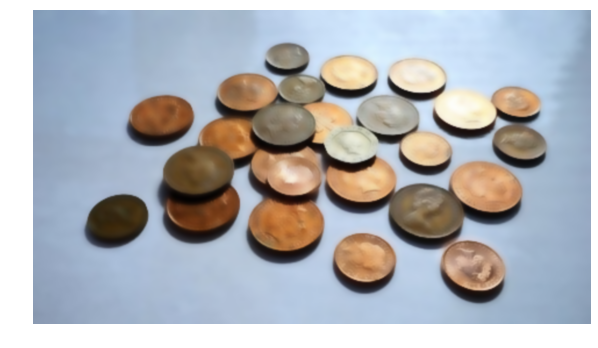

In [17]:
# MSER

image = url_to_image("https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/count/count9.jpg")

image = cv2.bilateralFilter(image,9,150,150)

gray = cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)
cv2_imshow(cv2.cvtColor(image,cv2.COLOR_BGR2RGB))

trackbarName = 'Test' 
windowName = 'TestW'

def on_trackbar(val):
    
    sl1 = cv2.getTrackbarPos('sl1', windowName)
    
    vis = image.copy()
    mser = cv2.MSER_create(_delta = val, _max_area=500, _min_area=70)
    regions, _ = mser.detectRegions(gray)
    hulls = [cv2.convexHull(p.reshape(-1, 1, 2)) for p in regions]
    cv2.polylines(vis, hulls, 1, (0, 255, 0))
    
    cv2.imshow(windowName, vis)
               
cv2.namedWindow(windowName)

cv2.createTrackbar('sl1', windowName, 3, 25, on_trackbar)


# Show some stuff
on_trackbar(1)
# Wait until user press some key
cv2.waitKey()
cv2.destroyAllWindows()

downloading https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/count/count9.jpg


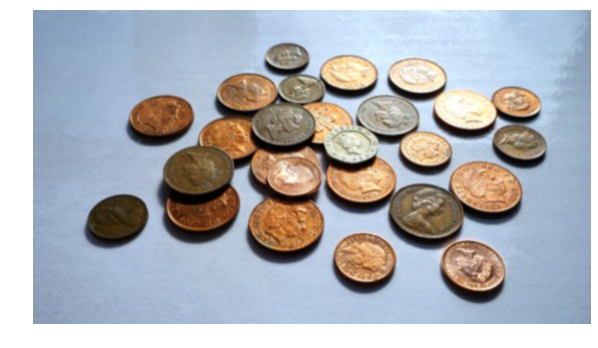

In [18]:
# blur

image = url_to_image("https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/count/count9.jpg")
gray = cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)
cv2_imshow(cv2.cvtColor(image,cv2.COLOR_BGR2RGB))

trackbarName = 'Test' 
windowName = 'TestW'

def on_trackbar(val):
    
    sl1 = cv2.getTrackbarPos('sl1', windowName)
    sl2 = cv2.getTrackbarPos('sl2', windowName)
    
    gray = cv2.bilateralFilter(image,sl1,sl2,sl2)
    
    cv2.imshow(windowName, gray)
               
cv2.namedWindow(windowName)

cv2.createTrackbar('sl1', windowName, 9, 100, on_trackbar)
cv2.createTrackbar('sl2', windowName, 75, 200, on_trackbar)


# Show some stuff
on_trackbar(1)
# Wait until user press some key
cv2.waitKey()
cv2.destroyAllWindows()

downloading https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/count/count9.jpg


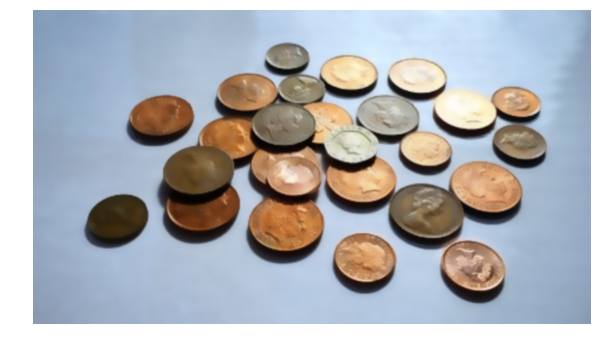

In [19]:
# canny

image = url_to_image("https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/count/count9.jpg")
image = cv2.bilateralFilter(image,9,75,75)

gray = cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)
cv2_imshow(cv2.cvtColor(image,cv2.COLOR_BGR2RGB))

trackbarName = 'Test' 
windowName = 'TestW'

def on_trackbar(val):
    
    sl1 = cv2.getTrackbarPos('sl1', windowName)
    sl2 = cv2.getTrackbarPos('sl2', windowName)
    
    edges = cv2.Canny(image,sl1,sl2)
    
    cv2.imshow(windowName, edges)
               
cv2.namedWindow(windowName)

cv2.createTrackbar('sl1', windowName, 1, 500, on_trackbar)
cv2.createTrackbar('sl2', windowName, 1, 500, on_trackbar)


# Show some stuff
on_trackbar(1)
# Wait until user press some key
cv2.waitKey()
cv2.destroyAllWindows()